In [2]:

import pandas as pd
import numpy as np
import warnings
import matplotlib.pyplot as plt
import pypopulation
warnings.filterwarnings("ignore")
import random
import statistics
import statistics
from matplotlib.ticker import MaxNLocator
import iso3166
import pycountry
import plotly
from urllib.request import urlopen
import json
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px
import os
os.chdir("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/dworkin_code_api")

authorship_hc=pd.read_csv('coreidd/df9_consensus_authorship_public.csv')

df_hc=pd.read_csv('coreidd/df9_articledata_0.7_public.csv')

df_cited_hc=pd.read_csv('coreidd/df9_consensus_citation_public.csv')






In [4]:
## Use in internal files, public files already have this column predetermined
## To be run with the large article data dataframe
def single_author_identification(df):
    df['has_single_author']=False
    df['has_single_author'].loc[df['first_auth']==df['last_auth']]=True
    return df
df_hc=single_author_identification(df_hc)
df_books=single_author_identification(df_books)
df_hc_60=single_author_identification(df_hc_60)
df_hc_80=single_author_identification(df_hc_80)

KeyError: 'first_auth'

In [8]:
def fix_countries(df):
    df['Country']=df['Country'].replace({'england':'United Kingdom (Great Britain)',
                                 'north ireland':'United Kingdom (Great Britain)',
                                 'wales':'United Kingdom (Great Britain)',
                                 'scotland':'United Kingdom (Great Britain)'})
    df['Country']=df['Country'].str.lower()
    df['global_north'].loc[df['Country']=='united kingdom (great britain)']=1

    return df

df_hc=fix_countries(df_hc)


In [210]:

def remove_self_citations(df):
    df['is_self_cite']=False
    
    df['is_self_cite'].loc[df['cited_first']==df['citing_first']]=True
    df['is_self_cite'].loc[df['cited_first']==df['citing_last']]=True
    df['is_self_cite'].loc[df['cited_last']==df['citing_first']]=True
    df['is_self_cite'].loc[df['cited_last']==df['citing_last']]=True

    return df

# Figure 0

In [16]:

ISO = {'AD': 'Andorra','AE': 'U Arab Emirates','AF': 'Afghanistan','AG': 'Antigua & Barbuda',
	'AI': 'Anguilla','AL': 'Albania','AM': 'Armenia','AN': 'Netherlands Antilles',
	'AO': 'Angola','AQ': 'Antarctica','AR': 'Argentina','AS': 'American Samoa','AT': 'Austria',
	'AU': 'Australia','AW': 'Aruba','AZ': 'Azerbaijan','BA': 'Bosnia and Herzegovina','BB': 'Barbados',
	'BD': 'Bangladesh','BE': 'Belgium','BF': 'Burkina Faso','BG': 'Bulgaria','BH': 'Bahrain',
	'BI': 'Burundi','BJ': 'Benin','BM': 'Bermuda','BN': 'Brunei Darussalam','BO': 'Bolivia','BR': 'Brazil',
	'BS': 'Bahama','BT': 'Bhutan','BU': 'Burma (no longer exists)','BV': 'Bouvet Island','BW': 'Botswana',
	'BY': 'Belarus','BZ': 'Belize','CA': 'Canada','CC': 'Cocos (Keeling) Islands','CF': 'Central African Republic',
	'CG': 'Dem Rep Congo','CH': 'Switzerland','CI': 'Côte D\'ivoire (Ivory Coast)','CK': 'Cook Iislands',
	'CL': 'Chile','CM': 'Cameroon','CN': 'Peoples R China','CO': 'Colombia','CR': 'Costa Rica',
	'CS': 'Czechoslovakia (no longer exists)','CU': 'Cuba','CV': 'Cape Verde','CX': 'Christmas Island',
	'CY': 'Cyprus','CZ': 'Czech Republic','DD': 'Fed Rep Ger','DE': 'Germany','DJ': 'Djibouti',
	'DK': 'Denmark','DM': 'Dominica','DO': 'Dominican Republic','DZ': 'Algeria','EC': 'Ecuador',
	'EE': 'Estonia','EG': 'Egypt','EH': 'Western Sahara','ER': 'Eritrea','ES': 'Spain','ET': 'Ethiopia',
	'FI': 'Finland','FJ': 'Fiji','FK': 'Falkland Islands (Malvinas)','FM': 'Micronesia','FO': 'Faroe Islands',
	'FR': 'France','FX': 'France, Metropolitan','GA': 'Gabon','GB': 'United Kingdom (Great Britain)',
	'GD': 'Grenada','GE': 'Georgia','GF': 'French Guiana','GH': 'Ghana','GI': 'Gibraltar','GL': 'Greenland',
	'GM': 'Gambia','GN': 'Guinea','GP': 'Guadeloupe','GQ': 'Equatorial Guinea','GR': 'Greece',
	'GS': 'South Georgia and the South Sandwich Islands','GT': 'Guatemala','GU': 'Guam','GW': 'Guinea-Bissau',
	'GY': 'Guyana','HK': 'Hong Kong','HM': 'Heard & McDonald Islands','HN': 'Honduras','HR': 'Croatia',
	'HT': 'Haiti','HU': 'Hungary','ID': 'Indonesia','IE': 'Ireland','IL': 'Israel','IN': 'India',
	'IO': 'British Indian Ocean Territory','IQ': 'Iraq','IR': 'Iran','IS': 'Iceland','IT': 'Italy',
    'JM': 'Jamaica','JO': 'Jordan','JP': 'Japan','KE': 'Kenya','KG': 'Kyrgyzstan','KH': 'Cambodia',
	'KI': 'Kiribati','KM': 'Comoros','KN': 'St. Kitts and Nevis','KP': 'Korea, Democratic People\'s Republic of',
	'KR': 'South Korea','KW': 'Kuwait','KY': 'Cayman Islands','KZ': 'Kazakhstan','LA': 'Laos','LB': 'Lebanon',
	'LC': 'Saint Lucia','LI': 'Liechtenstein','LK': 'Sri Lanka','LR': 'Liberia','LS': 'Lesotho','LT': 'Lithuania',
	'LU': 'Luxembourg','LV': 'Latvia','LY': 'Libyan Arab Jamahiriya','MA': 'Morocco','MC': 'Monaco',
	'MD': 'Moldova, Republic of','MG': 'Madagascar','MH': 'Marshall Islands','ML': 'Mali','MK':'North Macedonia',
	'MN': 'Mongolia','MM': 'Myanmar','MO': 'Macau','MP': 'Northern Mariana Islands','MQ': 'Martinique',
	'MR': 'Mauritania','MS': 'Monserrat','MT': 'Malta','MU': 'Mauritius','MV': 'Maldives','MW': 'Malawi',
	'MX': 'Mexico','MY': 'Malaysia','MZ': 'Mozambique','NA': 'Namibia','NC': 'New Caledonia',
	'NE': 'Niger','NF': 'Norfolk Island','NG': 'Nigeria','NI': 'Nicaragua','NL': 'Netherlands',
	'NO': 'Norway','NP': 'Nepal','NR': 'Nauru','NT': 'Neutral Zone (no longer exists)','NU': 'Niue',
    'NZ': 'New Zealand','OM': 'Oman','PA': 'Panama','PE': 'Peru','PF': 'French Polynesia','PG': 'Papua New Guinea',
    'PH': 'Philippines','PK': 'Pakistan','PL': 'Poland','PM': 'St. Pierre & Miquelon','PN': 'Pitcairn',
	'PR': 'Puerto Rico','PT': 'Portugal','PW': 'Palau','PY': 'Paraguay','QA': 'Qatar','RE': 'Réunion',
	'RO': 'Romania','RU': 'Russia','RS':'Serbia','RW': 'Rwanda','SA': 'Saudi Arabia','SB': 'Solomon Islands',
	'SC': 'Seychelles','SD': 'Sudan','SE': 'Sweden','SG': 'Singapore','SH': 'St. Helena','SI': 'Slovenia',
	'SJ': 'Svalbard & Jan Mayen Islands','SK': 'Slovakia','SL': 'Sierra Leone','SM': 'San Marino',
	'SN': 'Senegal','SO': 'Somalia','SR': 'Suriname','ST': 'Sao Tome & Principe',
	'SU': 'Union of Soviet Socialist Republics (no longer exists)','SV': 'El Salvador','SY': 'Syrian Arab Republic',
	'SZ': 'Swaziland','TC': 'Turks & Caicos Islands','TD': 'Chad','TF': 'French Southern Territories',
	'TG': 'Togo','TH': 'Thailand','TJ': 'Tajikistan','TK': 'Tokelau','TM': 'Turkmenistan','TN': 'Tunisia',
	'TO': 'Tonga','TP': 'East Timor','TR': 'Turkey','TT': 'Trinidad Tobago','TV': 'Tuvalu','TW': 'Taiwan',
	'TZ': 'Tanzania','UA': 'Ukraine','UG': 'Uganda','UM': 'United States Minor Outlying Islands',
    'US': 'usa','UY': 'Uruguay','UZ': 'Uzbekistan','VA': 'Vatican City State (Holy See)',
	'VC': 'St. Vincent & the Grenadines','VE': 'Venezuela','VG': 'British Virgin Islands','VI': 'United States Virgin Islands',
	'VN': 'Vietnam','VU': 'Vanuatu','WF': 'Wallis & Futuna Islands','WS': 'Samoa','YD': 'Democratic Yemen (no longer exists)',
	'YE': 'Yemen','YT': 'Mayotte','YU': 'Yugoslavia','ZA': 'South Africa','ZM': 'Zambia','ZR': 'Zaire','ZW': 'Zimbabwe',
       'CD':'Democratic Republic of the Congo','SS':'South Sudan'
      }
ISO = {v: k for k, v in ISO.items()}
ISO =  {k.lower(): v for k, v in ISO.items()}


In [18]:
import matplotlib
def dataframe_creation_map(df0,authorship,title):
    country_paper=pd.DataFrame(columns=['Country','PPM','Raw_papers','Global_North'])
    countries=list(ISO.keys())
    df=pd.merge(df0,authorship,how='inner')

    for country in df['Country'].unique():
        try:
            country1=ISO[country]
            info = pycountry.countries.get(alpha_2=country1)
            country3=info.alpha_3

            df_country=df.loc[df['Country']==country]
            papers=len(df_country)
            try:
                pop=pypopulation.get_population(country1)
                ppm=papers/(pop/1000000)

            except:
                ppm=0
            try:
                GN=list(df_country['global_north'].unique())[0]

                if GN==1:
                    GN='Global North'
                else:
                    GN='Global South'
            except: GN='Global South'
            if pop>1000000:
                df2 = pd.DataFrame([[country3,ppm,papers,GN]],columns=['Country','PPM','Raw_papers','Global_North'])
                country_paper=pd.concat([df2, country_paper])

        except:
            df2 = pd.DataFrame([[country3,ppm,papers,GN]],columns=['Country','PPM','Raw_papers','Global_North'])
            country_paper=pd.concat([df2, country_paper])
    country_paper=country_paper.sort_values('PPM')
    country_paper['Raw_papers']=country_paper['Raw_papers'].astype(float)
    country_paper['Country'].unique()

    country_paper=country_paper.reset_index()



    years=[]
    papers=[]
    for year in df['PY'].unique():
        df_year=df.loc[df['PY']==year]
        paper=len(df_year['article_id'].unique())
        years.append(year)
        papers.append(paper)

 
    df_authorship_count=pd.DataFrame({'Year':years,'Papers':papers})

    

    return country_paper,df_authorship_count
country_paper_hc,hc_author_count=dataframe_creation_map(df_hc,authorship_hc,'hc')


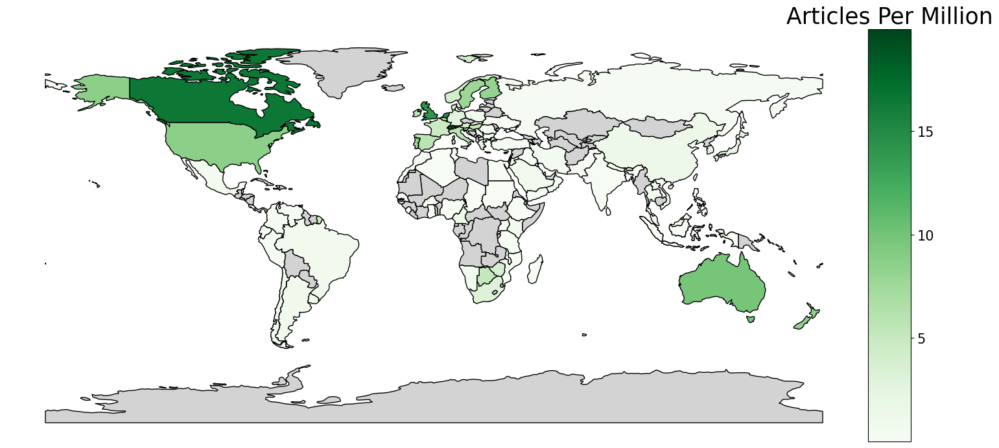

In [22]:
import geopandas
from mpl_toolkits.axes_grid1 import make_axes_locatable
world = geopandas.read_file('/Users/alexesmerritt/Downloads/ne_110m_admin_0_countries/ne_110m_admin_0_countries.shp')
world=pd.merge(country_paper_hc,world,right_on='ADM0_A3',left_on='Country',how='outer')
world=geopandas.GeoDataFrame(world)
world.crs = 'epsg:3395'
fig, ax = plt.subplots(1, 1,figsize=(18,18))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
world.plot(column='PPM',cmap='Greens',edgecolor='black',legend=True,figsize=(9,9),ax=ax,cax=cax,missing_kwds={
        "color": "lightgrey",
        "edgecolor": "k",
        "label": "Missing values",
    })
ax.axis('off')
cax.set_title('Articles Per Million',fontsize=25)
cax.set_yticks([5,10,15])
cax.tick_params(axis='y', which='major', labelsize=15)
plt.savefig(str('Figures/fig1a.png'),dpi=250)

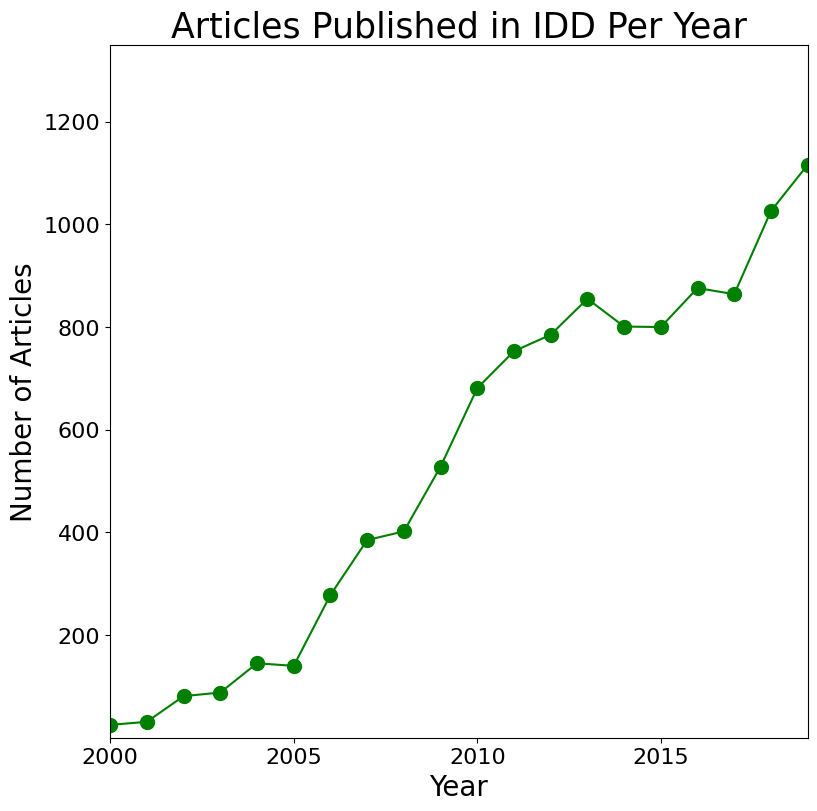

In [23]:

fig, ax = plt.subplots(1, 1,figsize=(9,9))
hc_author_count=hc_author_count.sort_values('Year')
hc_author_count.plot(y='Papers',x='Year',ax=ax,marker='o',ms=10,color='green')
ax.set_xticks((2000,2005,2010,2015))
ax.set_yticks((200,400,600,800,1000,1200))
ax.tick_params(axis='both', which='major', labelsize=16)
ax.set_xlabel('Year', fontsize=20)
ax.set_ylabel('Number of Articles', fontsize=20)
ax.set_ylim(0,1350)
ax.set_xlim(2000,2019)
ax.set_title('Articles Published in IDD Per Year',fontsize=25)
ax.get_legend().remove()
plt.savefig('Figures/fig1b.png',dpi=1000)

## GENDER AUTHORSHIP DATA

In [29]:
def gender_authorship_part1(df,authorship,dataset,scope,author,model):
    df=pd.merge(df,authorship,how='inner')
    df=df.loc[df['PY']>=2000]
    
    

    ##Altering for scope
    if scope=="USA":
        df=df.loc[df['Country']=='usa']

    if scope=='Global North':
        df=df.loc[df['global_north']==1]

    if scope=='UK':
        df=df.loc[df['Country']=='united kingdom (great britain)']

    ##############################  CREATING DATAFRAME FOR FIRST/LAST AUTHOR    ##############################
    ##Filtering for inclusion in figure 1a
    #CREATING DF BY MLM AND AUTHOR TYPE
    if model=='Genderize': 
        if author=='LA':
            df_authors=df.rename(columns={'LA_genderize':'Gender','PY':'Year'})[['Year','article_id','Gender']]
        if author=='FA':
            df_authors=df.rename(columns={'FA_genderize':'Gender','PY':'Year'})[['Year','article_id','Gender']]
    if model=='Namsor':
        if author=='LA':
            df_authors=df.rename(columns={'LA_gender':'Gender','PY':'Year'})[['Year','article_id','Gender']]
        if author=='FA':
            df_authors=df.rename(columns={'FA_gender':'Gender','PY':'Year'})[['Year','article_id','Gender']]

    ######## ONLY ARTICLES WITH BOTH AUTHOR GENDERS REPORTED ########
    genders=['M','W']
    df_authors=df_authors.loc[df_authors['Gender'].isin(genders)]
   


    ##############################  CREATING DATAFRAME FOR AUTHOR PAIRINGS     ##############################
    ######## ONLY ARTICLES WITH BOTH AUTHOR GENDERS REPORTED, RENAMINS CORRESPONDING COLUMN FOR MLM ########
    accepted_groupings=['WW','WM','MW','MM']
    if model=='Genderize':
        ##selecting appropriate MLM model
        df_removed_singles=df.rename(columns={'AG':'Pairings'})
        ##removing papers with missing author gender data
        df_removed_singles=df_removed_singles.loc[df_removed_singles['Pairings'].isin(accepted_groupings)]
    else:
        ##selecting appropriate MLM model
        df_removed_singles=df.rename(columns={'AG_namsor':'Pairings'})
        ##removing papers with missing author gender data
        df_removed_singles=df_removed_singles.loc[df_removed_singles['Pairings'].isin(accepted_groupings)]
    
    #################################  REMOVING PAPERS WITH SINGLE AUTHORS ################################# 
    df_removed_singles=df_removed_singles.loc[df_removed_singles['has_single_author']==False]



    
    ##################################  CALCULATING COUNTS FOR YEAR #########################################
    years=df_authors['Year'].unique() # list of years to loop thorugh
    ##Prepping Data 
    df_yearly_author=pd.DataFrame(columns=['Year','Woman','Man'])
    df_yearly=pd.DataFrame(columns=['Year','WW','WM','MW','MM','WW_std','WM_std','MW_std','MM_std''count'])
    
    
    for year in years:
        df_year_authors=df_authors.loc[df_authors['Year']==year]  #Adjusting first/last author df to the year
        df_year=df_removed_singles.loc[df_removed_singles['PY']==year] #Adjusting author pairing df to the year
        LA_genders=list(df_year_authors['Gender']) ##List of author genders in a given year
        pairings=list(df_year['Pairings']) ##List of author pairings in a given year
        num_author_papers=len(df_year_authors)  #number of articles with authors reported in a given year
        num_pairings_papers=len(df_year)  #number of articles with authors pairings reported in a given year
        w=[]
        m=[]
        ww=[]
        wm=[]
        mw=[]
        mm=[]
        ##Bootstrappings
        for i in list(range (0,1000)):
            ## RANDOM SELECTION OF AUTHORS WITH REPLACEMENT
            random_authors=random.choices(LA_genders,k=num_author_papers)
            ##COUNTING AUTHORS REPORTED FOR EACH GENDER
            try:
                w1=random_authors.count('W')
            except:
                w1=0
            try:
                m1=random_authors.count('M')
            except:
                m1=0
            
            ##PROPORTION OF AUTHORS OF EACH GENDER IN BOOTSTRAP
            w.append(w1/num_author_papers)
            m.append(m1/num_author_papers)

            ##Bootstrapping for 1b

            random_pairings=random.choices(pairings,k=num_pairings_papers)

            try:
                ww1=random_pairings.count('WW')
            except:
                ww1=0
            try:
                mw1=random_pairings.count('MW')
            except:
                mw1=0

            try:
                wm1=random_pairings.count('WM')
            except:
                wm1=0
            try:
                mm1=random_pairings.count('MM')
            except:
                mm1=0


            num_citations=ww1+mw1+wm1+mm1

            ww.append(ww1/num_citations)
            mw.append(mw1/num_citations)
            wm.append(wm1/num_citations)
            mm.append(mm1/num_citations)

        mm_a=sum(mm)/len(mm)
        wm_a=sum(wm)/len(wm)
        mw_a=sum(mw)/len(mw)
        ww_a=sum(ww)/len(ww)
        mm_std=statistics.stdev(mm)
        mw_std=statistics.stdev(mw)
        wm_std=statistics.stdev(wm)
        ww_std=statistics.stdev(ww)
        df2=pd.DataFrame({'Year':year,'WW':ww_a,'WM':wm_a,'MW':mw_a,'MM':mm_a,'WW_std':ww_std,'WM_std':wm_std,'MW_std':mw_std,'MM_std':mm_std,'count':num_citations}, index=[0])
        df_yearly=pd.concat([df_yearly,df2])

        man=sum(m)/len(m)
        woman=sum(w)/len(w)
        man_std=statistics.stdev(m)
        woman_std=statistics.stdev(w)
        df2=pd.DataFrame({'Year':year,'Man':man,'Woman':woman,'Woman_std':woman_std,'Man_std':man_std}, index=[0])
        df_yearly_author=pd.concat([df_yearly_author,df2])



##Prepping Dataframes
    df_yearly_author.Woman = df_yearly_author.Woman.astype(float)
    df_yearly_author.Man = df_yearly_author.Man.astype(float)
    df_yearly_author.Year = df_yearly_author.Year.astype(float)


    df_yearly_author=df_yearly_author.sort_values(by='Year').reset_index()

    df_yearly.WW = df_yearly.WW.astype(float)
    df_yearly.MW = df_yearly.MW.astype(float)
    df_yearly.WM = df_yearly.WM.astype(float)
    df_yearly.MM = df_yearly.MM.astype(float)
    df_yearly.Year = df_yearly.Year.astype(float)


    df_yearly=df_yearly.sort_values(by='Year').reset_index()
    return df_yearly,df_yearly_author




def gender_authorship_data(df,authorship,dataset,scope,author,model):
    #Calculating the authorship proportions for the opposite author, in order to calculate expected groupings
    if author=='LA':
        df_yearly,df_yearly_author=gender_authorship_part1(df,authorship,dataset,scope,author,model)
        LA_yearly=df_yearly
        LA_yearly_author=df_yearly_author
        FA_yearly,FA_yearly_author=gender_authorship_part1(df,authorship,dataset,scope,'FA',model)
        
        LA_women=float(LA_yearly_author['Woman'].iloc[-1])
        LA_men=1-LA_women
        FA_women=float(FA_yearly_author['Woman'].iloc[-1])
        FA_men=1-FA_women
        women=LA_women
        men=LA_men
    if author=='FA':
        df_yearly,df_yearly_author=gender_authorship_part1(df,authorship,dataset,scope,author,model)
        FA_yearly=df_yearly
        FA_yearly_author=df_yearly_author

        LA_yearly,LA_yearly_author=gender_authorship_part1(df,authorship,dataset,scope,'LA',model)

        LA_women=float(LA_yearly_author['Woman'].iloc[-1])
        LA_men=1-LA_women
        FA_women=float(FA_yearly_author['Woman'].iloc[-1])
        FA_men=1-FA_women
        women=FA_women
        men=FA_men
    
    
    genders=[LA_women,LA_men,FA_women,FA_men,women,men]
    df_genders=pd.DataFrame(genders,columns=['Items'])
    df_genders.to_csv('coreidd/Figures/df_fig1_genders_'+dataset+'_'+model+'_'+scope+'_'+author+'.csv')
    df_yearly.to_csv('coreidd/Figures/df_fig1_pairings_'+dataset+'_'+model+'_'+scope+'_'+author+'.csv')
    df_yearly_author.to_csv('coreidd/Figures/df_fig1_authors_'+dataset+'_'+model+'_'+scope+'_'+author+'.csv')



gender_authorship_data(df_hc,authorship_hc,'Highly Cited','World','LA','Genderize')

## Gender Citation Data

In [39]:
%%time
def gender_citation_data(df, df_cited,dataset,scope,model,include_self_cite=False, consensus=90):
    df_cited=df_cited.rename(columns={'article_id':'cited_article','in_bib_of_article_id':'citing_article'})
    df=df.loc[df['has_single_author']==False]
########################### ADDING GENDERS OF AUTHORS CITED AND CITING  #####################################
    if model=='Genderize':
        df=df.loc[df['has_single_author']==False]
        df_cited=df_cited.rename(columns={'article_id':'cited_article','in_bib_of_UT':'citing_article'})
        #### REMOVING SINGLE AUTHORS FROM MERGING
        df_gender1=df[['article_id', 'AG']]
        df_gender2=df[['article_id', 'AG','global_north','PY','Country']]
        #### ADD CITED AUTHORS GENDER
        df_cited=df_cited.merge(df_gender1, left_on='cited_article', right_on='article_id',how='left')

        df_cited=df_cited.rename(columns={'AG':'cited_gender','PY':'PY_cited_article'})
        #### ADD CITING AUTHORS GENDER
        df_cited=df_cited.merge(df_gender2, left_on='citing_article', right_on='article_id',how='left')

        df_cited=df_cited.rename(columns={'AG':'citing_gender'})
        df_cited=df_cited.drop(columns={'article_id_x','article_id_y'})
        
    if model=='Namsor':
        df_cited=df_cited.rename(columns={'article_id':'cited_article','in_bib_of_UT':'citing_article'})
        #### REMOVING SINGLE AUTHORS FROM MERGING
        df_gender1=df[['article_id', 'AG_namsor', 'first_auth','last_auth']]
        df_gender2=df[['article_id', 'AG_namsor','global_north','Country', 'first_auth','last_auth','PY']]
        #### ADD CITED AUTHORS GENDER
        df_cited=df_cited.merge(df_gender1, left_on='cited_article', right_on='article_id')
        df_cited=df_cited.rename(columns={'AG_namsor':'cited_gender','first_auth':'cited_first','last_auth':'cited_last','PY':'PY_cited_article'})
        #### ADD CITING AUTHORS GENDER
        df_cited=df_cited.merge(df_gender2, left_on='citing_article', right_on='article_id')
        df_cited=df_cited.rename(columns={'AG_namsor':'citing_gender','first_auth':'citing_first','last_auth':'citing_last'})
        df_cited=df_cited.drop(columns={'UT_x','UT_y'})
        df_cited=remove_self_citations(df_cited)


    
    #Removing papers where there are missing genders or threshold is too low
    accepted_groups=['WW','WM','MW','MM'] 
    df_cited=df_cited.loc[df_cited['citing_gender'].isin(accepted_groups)]
    df_cited=df_cited.loc[df_cited['cited_gender'].isin(accepted_groups)]

    # ##REMOVING SELF CITATIONS:
    if include_self_cite==False:
        df_cited=df_cited.loc[df_cited['is_self_cite']==False]

    df_cited=df_cited.loc[df_cited['include_'+str(consensus)]==True]


    # Adjusting dataframe to scope of the analysis
    if scope=='Global North':
        df_cited=df_cited.loc[df_cited['global_north']==1]
    if scope=='UK':
        df_cited=df_cited.loc[df_cited['Country']=='united kingdom (great britain)']
    if scope=='USA':
        df_cited=df_cited.loc[df_cited['Country']=='usa']

    df_WW_citing_WW=pd.DataFrame()
    df_WW_citing_WM=pd.DataFrame()
    df_WW_citing_MW=pd.DataFrame()
    df_WW_citing_MM=pd.DataFrame()
    df_MM_citing_WW=pd.DataFrame()
    df_MM_citing_WM=pd.DataFrame()
    df_MM_citing_MW=pd.DataFrame()
    df_MM_citing_MM=pd.DataFrame()
    groups_of_study=['MM','WW']
    for x in list(range(0,2)):
        group=groups_of_study[x]
        ##Creating dataframe to store information
        df_citation_comp=pd.DataFrame()
        df_author=df_cited.loc[df_cited['citing_gender']==group] ## Specifiying if cited author is MM or WW
        df_author=df_author.loc[df_author['PY']>=2000] ## Only viewing papers written on or after 2000
        for year in list(df_author['PY'].unique()): ## Looping through years
            df_year=df_author.loc[df_author['PY']==year]
            num_citations=len(df_year) ##Total number of qualified citations in a given year for WW or MM
            num_papers=len(df_year['citing_article'].unique()) ## Number of unique articles in field
            unique_papers_year=list(df_year['citing_article'].unique())
            ww=[]
            mw=[]
            wm=[]
            mm=[]
            for i in list(range (0,1000)): ##Bootstrapping 1000 times
                papers=random.choices(unique_papers_year,k=num_papers) ##random selection of citing papers with replacement
                ## Counting different gender pair citations in randomly selected papers
                list_of_count_dicts = [df_year.loc[df_year.citing_article==paper]['cited_gender'].value_counts() for paper in papers]
                counts=pd.DataFrame(list_of_count_dicts)

                try:
                    ww1=counts['WW'].sum()
                except:
                    ww1=0
                try:
                    mw1=counts['MW'].sum()
                except:
                    mw1=0

                try:
                    wm1=counts['WM'].sum()
                except:
                    wm1=0
                try:
                    mm1=counts['MM'].sum()
                except:
                    mm1=0


                num_citations=ww1+mw1+wm1+mm1
                ### Adding counts for bootstrapping to list for average and std calculations
                ww.append(ww1/num_citations)
                mw.append(mw1/num_citations)
                wm.append(wm1/num_citations)
                mm.append(mm1/num_citations)

                ##Adding to dataframes for T-Test
            if group=='MM':
              df_MM_citing_WW[str(year)]=ww
              df_MM_citing_WM[str(year)]=mw
              df_MM_citing_MW[str(year)]=wm
              df_MM_citing_MM[str(year)]=mm
            elif group=='WW':
              df_WW_citing_WW[str(year)]=ww
              df_WW_citing_WM[str(year)]=mw
              df_WW_citing_MW[str(year)]=wm
              df_WW_citing_MM[str(year)]=mm

            mm_a=sum(mm)/len(mm)
            wm_a=sum(wm)/len(wm)
            mw_a=sum(mw)/len(mw)
            ww_a=sum(ww)/len(ww)

            mm_std=statistics.stdev(mm)

            wm_std=statistics.stdev(wm)

            mw_std=statistics.stdev(mw)

            ww_std=statistics.stdev(ww)



            
            df2=pd.DataFrame({'Year':year,'WW':ww_a,'WM':wm_a,'MW':mw_a,'MM':mm_a,
                              'WW_std':ww_std,'WM_std':wm_std,'MW_std':mw_std,'MM_std':mm_std,'num_cite':num_citations},index=[0])
            df_citation_comp=pd.concat([df2,df_citation_comp],ignore_index=True)


        #df_citation_comp=df_citation_comp.sort_values('Year')
        df_yearly=df_citation_comp
     
        if x==0:
            df_MM=df_yearly
        if x==1:
            df_WW=df_yearly



    if include_self_cite==True:
        self_cite='_include_self_cite'
    else: 
        self_cite=''
    
    df_MM.to_csv('coreidd/Figures/df_fig2_MM_'+dataset+'_'+model+'_'+scope+self_cite+'.csv', index=False)
    df_WW.to_csv('coreidd/Figures/df_fig2_WW_'+dataset+'_'+model+'_'+scope+self_cite+'.csv', index=False)


    df_MM_citing_WW.to_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Gender/MM_citing_WW"+dataset+'_'+model+'_'+scope+self_cite+".csv", index=False)
    df_MM_citing_WM.to_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Gender/MM_citing_WM"+dataset+'_'+model+'_'+scope+self_cite+".csv", index=False)
    df_MM_citing_MW.to_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Gender/MM_citing_MW"+dataset+'_'+model+'_'+scope+self_cite+".csv", index=False)
    df_MM_citing_MM.to_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Gender/MM_citing_MM"+dataset+'_'+model+'_'+scope+self_cite+".csv", index=False)

    df_WW_citing_WW.to_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Gender/WW_citing_WW"+dataset+'_'+model+'_'+scope+self_cite+".csv", index=False)
    df_WW_citing_WM.to_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Gender/WW_citing_WM"+dataset+'_'+model+'_'+scope+self_cite+".csv", index=False)
    df_WW_citing_MW.to_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Gender/WW_citing_MW"+dataset+'_'+model+'_'+scope+self_cite+".csv", index=False)
    df_WW_citing_MM.to_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Gender/Ww_citing_MM"+dataset+'_'+model+'_'+scope+self_cite+".csv", index=False)



# gender_citation_data(df_hc, df_cited_hc,'Highly Cited','World','Genderize')


# gender_citation_data(df_hc_80,df_cited_hc,'Highly Cited_80','World','Genderize')
# gender_citation_data(df_hc_60,df_cited_hc,'Highly Cited_60','World','Genderize')

# gender_citation_data(df_hc, df_cited_hc,'Highly Cited','World','Genderize',include_self_cite=True)

# gender_citation_data(df_hc, df_cited_hc,'Highly Cited_75','World','Genderize',consensus=75)


# gender_citation_data(df_hc, df_cited_hc,'Highly Cited','World','Namsor')



# gender_citation_data(df_hc, df_cited_hc,'Highly Cited','Global North','Genderize')
gender_citation_data(df_hc, df_cited_hc,'Highly Cited','USA','Genderize')
gender_citation_data(df_hc, df_cited_hc,'Highly Cited','UK','Genderize')




CPU times: user 1.34 s, sys: 130 ms, total: 1.47 s
Wall time: 1.53 s


# Race Authorship Data

In [43]:
%time
def race_authorship(df,authorship,dataset,scope,author,model):
    df=pd.merge(df,authorship,how='right') ##merging dataframe with races, with dataframe that only has authorship
    #df=df.loc[df['PY']>=2000
################################### ALTERING FOR SCOPE AND MLM PACKAGE #########################################    
    ##Altering for scope
    if scope=="USA":   
        df=df.loc[df['Country']=='usa']
    if scope=='GN':
        df=df.loc[df['global_north']==1]
    if scope=='UK':
        df=df.loc[df['Country']=='united kingdom (great britain)']

    ##Filtering for auhtor position and MLA

    if model=='Ethnicolr':
        if author=='FA':
            column_name='FA_ethni_race'
        if author=='LA':
            column_name='LA_ethni_race'
    if model=='Namsor':
        if author=='LA':
            column_name='LA_race'
        if author=='FA':
            column_name='FA_race'
############################# Dataframe restructuring and creation to store outputs ###########################    
    ##Creation of a datframe that has first/last author data
    df_authors=df[['PY','article_id',column_name]]
    df_authors=df_authors.rename(columns={column_name:'Race','PY':'Year'})

    races=['W_NL','A','B_NL','HL']
    df_authors=df_authors.loc[df_authors['Race'].isin(races)]
   
    
    ## Creation of dataframes that store counts of each group following bootstrapping 
    df_yearly_author=pd.DataFrame(columns=['Year','A','B','H','W','A_std','B_std','H_std','W_std']) ##For first authors
    
############################### LOOPING THROUGH YEARS FOR COUNTS AND BOOTSTRAPPING #############################
    years=list(df['PY'].unique())
    
    for year in years:
        df_year_authors=df_authors.loc[df_authors['Year']==year]
        ######## CREATING A LIST OF RACES AND PAIRINGS FOR RANDOM SELECTION
        author_race=list(df_year_authors['Race']) ##list of first/last author race
        ##Getting a count of authors and papers for bootrapping
        num_author_papers=len(df_year_authors)

        ##EMPTY Lists for storing
        w=[]
        a=[]
        b=[]
        h=[]
        for i in list(range (0,1000)):
            ##Bootstrapping
            random_authors=random.choices(author_race,k=num_author_papers)
            try:
                w1=random_authors.count('W_NL')
            except:
                w1=0
            try:
                a1=random_authors.count('A')
            except:
                a1=0
            try:
                b1=random_authors.count('B_NL')
            except:
                b1=0
            try:
                h1=random_authors.count('HL')
            except:
                h1=0



            if num_author_papers!=0:
                w.append(w1/num_author_papers)
                a.append(a1/num_author_papers)
                b.append(b1/num_author_papers)
                h.append(h1/num_author_papers)
            else:
                w.append(0)
                a.append(0)
                b.append(0)
                h.append(0)
        ###### Mean and STD of lists from bootstrapping
        w_a=statistics.mean(w)
        h_a=statistics.mean(h)
        b_a=statistics.mean(b)
        a_a=statistics.mean(a)

        w_std=statistics.stdev(w)
        h_std=statistics.stdev(h)
        b_std=statistics.stdev(b)
        a_std=statistics.stdev(a)



        df2=pd.DataFrame({'Year':year,'W':w_a,'B':b_a,'A':a_a,'H':h_a,'W_std':w_std,'B_std':b_std,'A_std':a_std,'H_std':h_std}, index=[0])

        df_yearly_author=pd.concat([df_yearly_author,df2])




    df_yearly_author.W = df_yearly_author.W.astype(float)
    df_yearly_author.B = df_yearly_author.B.astype(float)
    df_yearly_author.A = df_yearly_author.A.astype(float)
    df_yearly_author.H= df_yearly_author.H.astype(float)
    df_yearly_author.Year = df_yearly_author.Year.astype(float)


    df_yearly_author=df_yearly_author.sort_values(by='Year')
    df_yearly_author.to_csv('coreidd/Figures/df_fig3_authors_'+dataset+'_'+model+'_'+scope+'_'+author+'.csv')


race_authorship(df_hc,authorship_hc,'Highly Cited','USA','LA','Ethnicolr')
race_authorship(df_hc,authorship_hc,'Highly Cited','UK','LA','Ethnicolr')



CPU times: user 5 µs, sys: 0 ns, total: 5 µs
Wall time: 9.06 µs


# Race Citation Data

In [54]:
def race_citation_data(df, df_cited,dataset,scope1,scope2,model,include_self_cite=False,consensus=90):
    ## Ensuring all papers invovled are not single author
    df=df.loc[df['has_single_author']==False]
    ### Renaming columns to make it clearer
    df_cited=df_cited.rename(columns={'article_id':'cited_article','in_bib_of_article_id':'citing_article'})
    if model=='Ethnicolr':
        df_races1=df[['article_id', 'ARbin_ethni','global_north']]
        df_races2=df[['article_id', 'ARbin_ethni','global_north','PY']]
        df_races1=df_races1.rename(columns={'global_north':'global_north2'})
        #### ADD CITED AUTHORS RACE
        df_cited=df_cited.merge(df_races1, left_on='cited_article', right_on='article_id')
        df_cited=df_cited.rename(columns={'ARbin_ethni':'cited_race','PY':'PY_cited_paper'})
        #### ADD CITING AUTHORS RACE

        df_cited=df_cited.merge(df_races2, left_on='citing_article', right_on='article_id')
        df_cited=df_cited.rename(columns={'ARbin_ethni':'citing_race'})
        df_cited=df_cited.drop(columns={'article_id_x','article_id_y'})
    if model=='Namsor':
        df_races1=df[['article_id', 'ARbin_namsor','first_auth','last_auth','global_north']]
        df_races2=df[['article_id', 'ARbin_namsor','global_north','Country','first_auth','last_auth','PY']]
        df_races=df_races1.rename(columns={'global_north':'global_north2'})
        df_cited=df_cited.merge(df_races1, left_on='cited_article', right_on='article_id')
        df_cited=df_cited.rename(columns={'ARbin_namsor':'cited_race','first_auth':'cited_first','last_auth':'cited_last','global_north':'global_north2','PY':'PY_cited_paper'})
        df_cited=df_cited.merge(df_races2, left_on='citing_article', right_on='article_id')
        df_cited=df_cited.rename(columns={'ARbin_namsor':'citing_race','first_auth':'citing_first','last_auth':'citing_last'})
        df_cited=df_cited.drop(columns={'UT_x','UT_y'})
        df_cited=remove_self_citations(df_cited) 

    if include_self_cite==False:
        df_cited=df_cited.loc[df_cited['is_self_cite']==False]


    
    df_cited=df_cited.loc[df_cited['include_'+str(consensus)]==True] ### Making sure we use 90% consensus for the field

    ## Making sure the articles remaining have both races reported
    groups=['WW','WN','NW','NN']
    df_cited=df_cited.loc[df_cited['citing_race'].isin(groups)]

    ### Alterations for scope
    df_cited=df_cited.loc[df_cited['cited_race'].isin(groups)]

    ### Alterations for scope
    if scope1=='Global North':
        df_cited=df_cited.loc[df_cited['global_north']==1]
        if scope2=='Global North':
            df_cited=df_cited.loc[df_cited['global_north2']==1]
    if scope1=='UK':
        df_cited=df_cited.loc[df_cited['Country']=='united kingdom (great britain)']
    if scope1=='USA':
        df_cited=df_cited.loc[df_cited['Country']=='usa']
    

############################################## BOOSTRAPPING #################################################
    df_WW_citing_WW=pd.DataFrame()
    df_WW_citing_POC=pd.DataFrame()
    df_POC_citing_WW=pd.DataFrame()
    df_POC_citing_POC=pd.DataFrame()
    
    groups=[['WW'],['NN','WN','NW']] ## How to grouping will work for the analysis
    for x in list(range(0,2)):
        group=groups[x]
        df_citation_comp=pd.DataFrame()
        df_author=df_cited.loc[df_cited['citing_race'].isin(group)]
        df_author=df_author.loc[df_author['PY']>=2000]
        ## Loopingg through years
    
        for year in df_author['PY'].unique():
            df_year=df_author.loc[df_author['PY']==year]
            unique_papers_year=df_year['citing_article'].unique()
            num_papers=len(unique_papers_year)
            num_citations=len(df_year)
            #creating empty dataset to store results
            ww=[]
            nw=[]
            wn=[]
            nn=[]
            POC=[]
            ##Bootstrapping
            for i in list(range (0,3)):
                papers=random.choices(unique_papers_year,k=num_papers)
            
                
                ##Randomly selecting with replacement for articles published in a given year, and then analyzing their citations
                list_of_count_dicts = [df_year.loc[df_year.citing_article==paper]['cited_race'].value_counts() for paper in papers]

                counts=pd.DataFrame(list_of_count_dicts)
                try:
                    ww1=counts['WW'].sum()
                    
                except:
                    ww1=0
                try:
                    nw1=counts['NW'].sum()
                except:
                    nw1=0

                try:
                    wn1=counts['WN'].sum()
                except:
                    wn1=0
                try:
                    nn1=counts['NN'].sum()
                except:
                    nn1=0

                PoC1=nn1+wn1+nw1
                num_citations=ww1+nw1+wn1+nn1

                ww.append(ww1/num_citations)
                nw.append(nw1/num_citations)
                wn.append(wn1/num_citations)
                nn.append(nn1/num_citations)
                POC.append(PoC1/num_citations)


            ##Storing bootstrapping

            if x==0:
                df_WW_citing_WW[str(year)]=ww
                df_WW_citing_POC[str(year)]=POC
            else:
                df_POC_citing_WW[str(year)]=ww
                df_POC_citing_POC[str(year)]=POC
############ Calculating averages and std
            nn_a=sum(nn)/len(nn)
            wn_a=sum(wn)/len(wn)
            nw_a=sum(nw)/len(nw)
            ww_a=sum(ww)/len(ww)
            PoC_a=sum(POC)/len(POC)

            nn_std=statistics.stdev(nn)

            wn_std=statistics.stdev(wn)

            nw_std=statistics.stdev(nw)

            ww_std=statistics.stdev(ww)

            PoC_std=statistics.stdev(POC)


            df2=pd.DataFrame({'Year':year,'WW':ww_a,'WN':wn_a,'NW':nw_a,'NN':nn_a,
                              'WW_std':ww_std,'WN_std':wn_std,'NW_std':nw_std,'NN_std':nn_std,
                              'ANY_POC':PoC_a,'POC_STD':PoC_std,'num_cite':num_citations},index=[0])

            df_citation_comp=pd.concat([df2,df_citation_comp],ignore_index=True)

        df_citation_comp=df_citation_comp.sort_values('Year')
        df_yearly=df_citation_comp
        if x==0:
            df_WW=df_yearly

        if x==1:
            df_PoC=df_yearly


    if include_self_cite==False:
        self_cite=''
    else:
        self_cite='_include_self_cite'
        
    df_WW_citing_POC.to_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Race/WW_citing_POC"+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+".csv")
    df_WW_citing_WW.to_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Race/WW_citing_WW"+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+".csv")
          
    df_POC_citing_POC.to_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Race/POC_citing_POC"+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+".csv")
    df_POC_citing_WW.to_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Race/POC_citing_WW"+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+".csv")
            

    df_WW.to_csv('coreidd/Figures/df_fig4_WW_'+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+'.csv')
    df_PoC.to_csv('coreidd/Figures/df_fig4_PoC_'+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+'.csv')


race_citation_data(df_hc, df_cited_hc,'Highly Cited','Global North','Global North','Ethnicolr')


# GRAPHS

## Gender Graphs

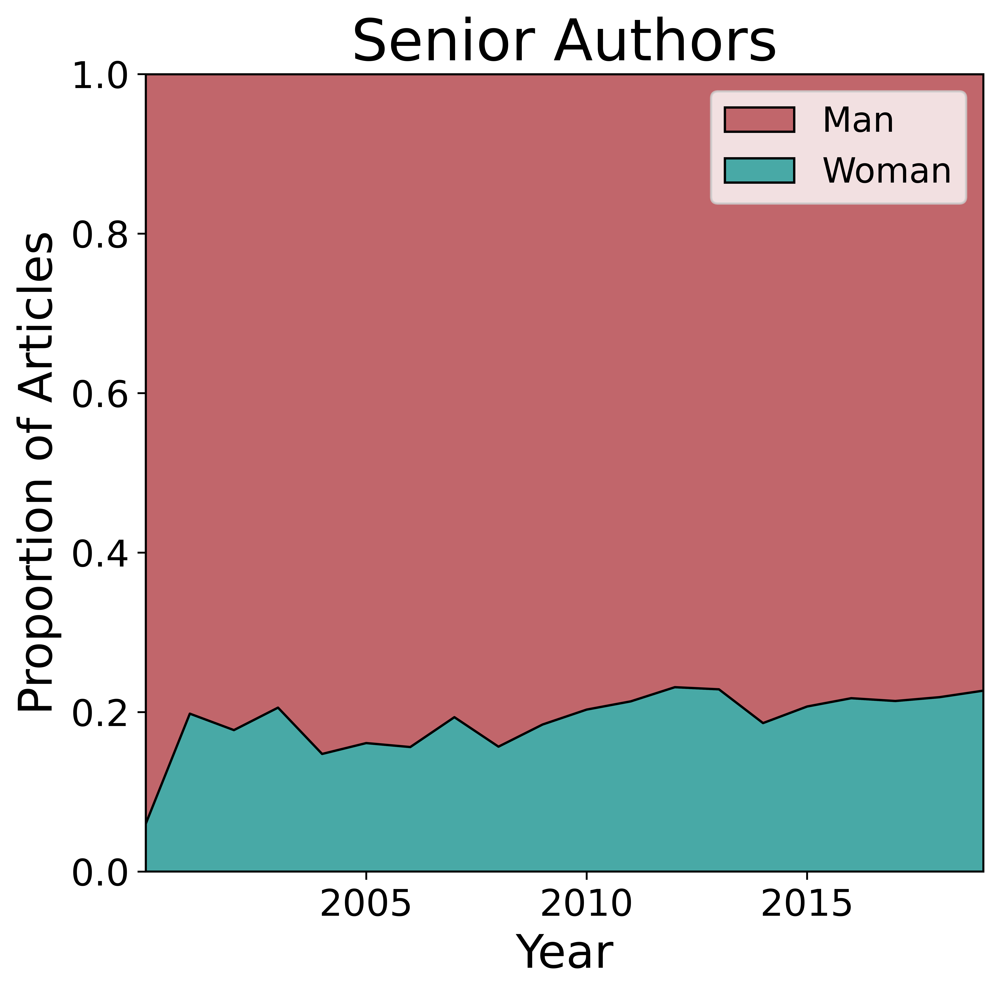

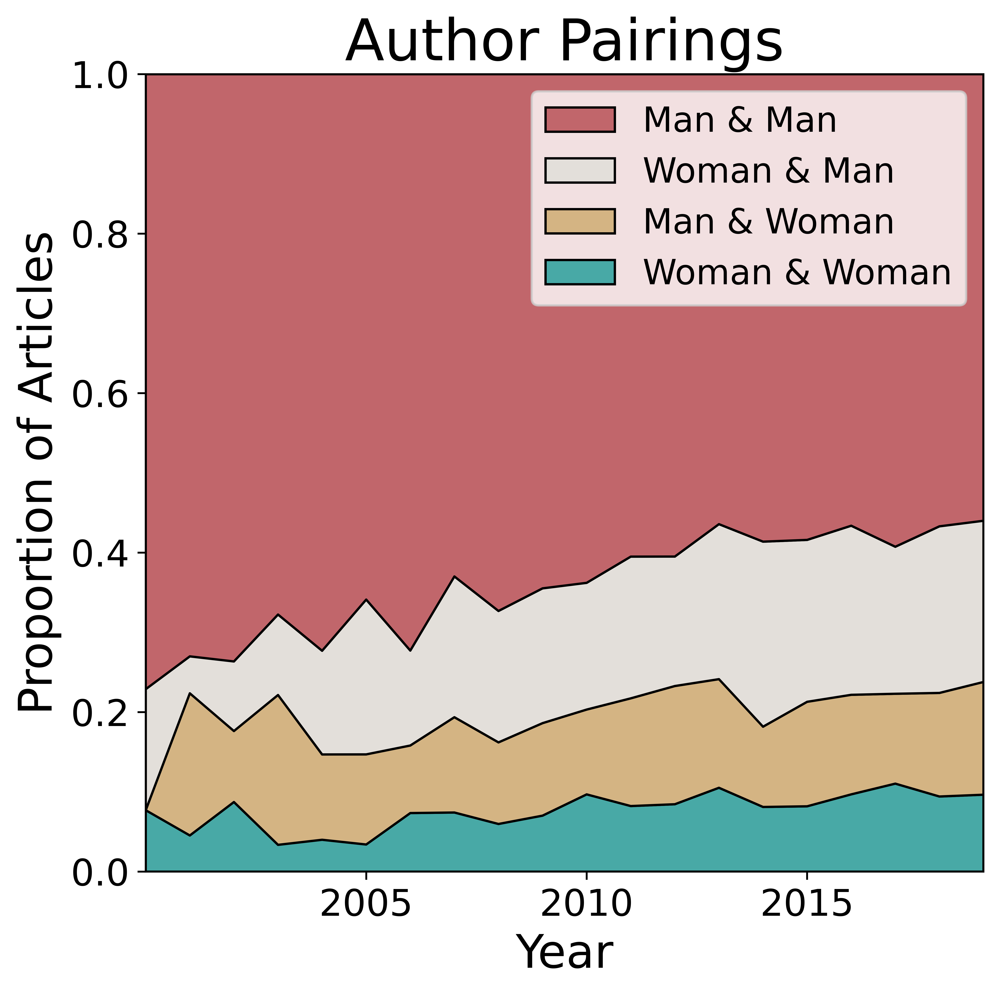

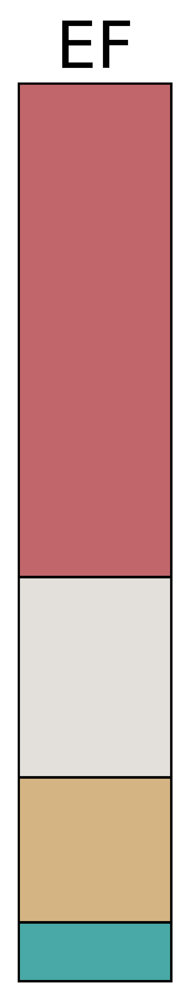

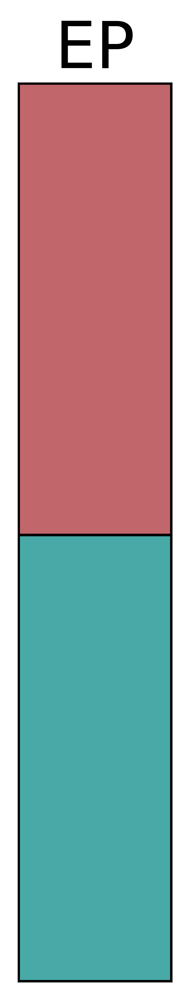

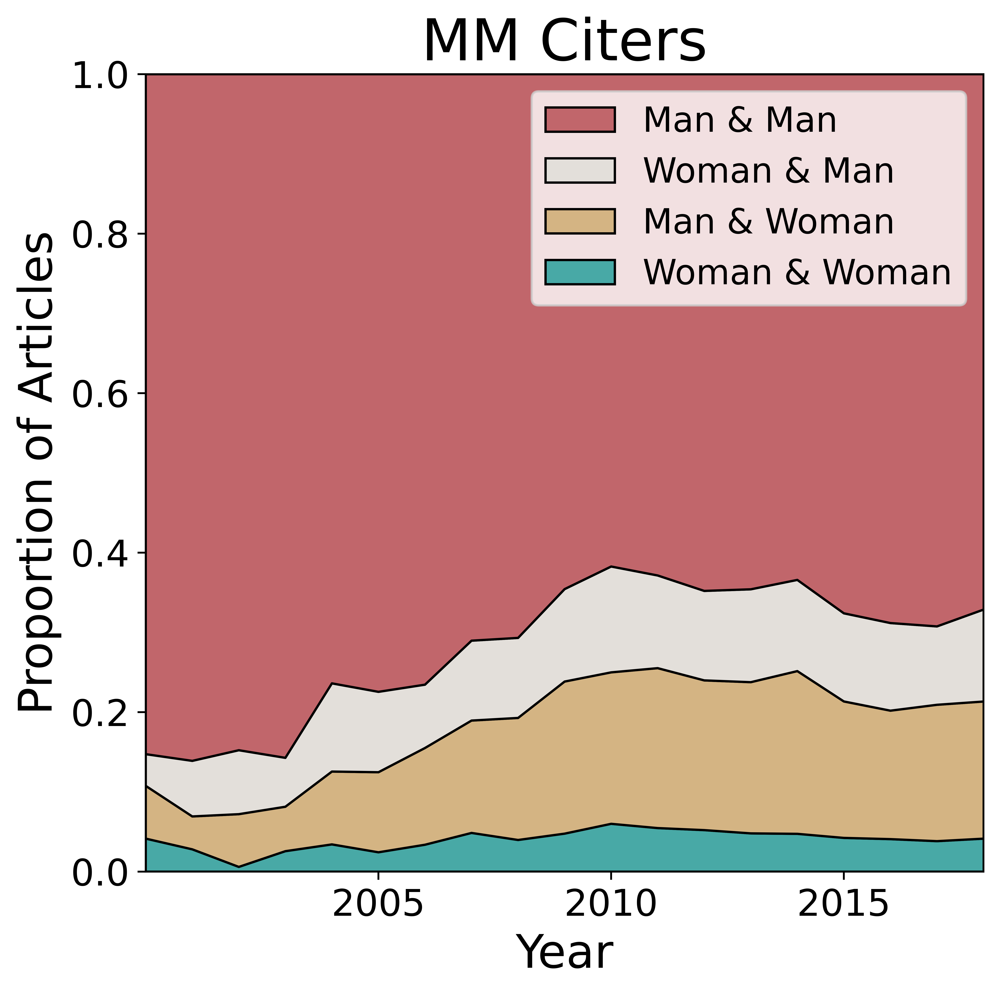

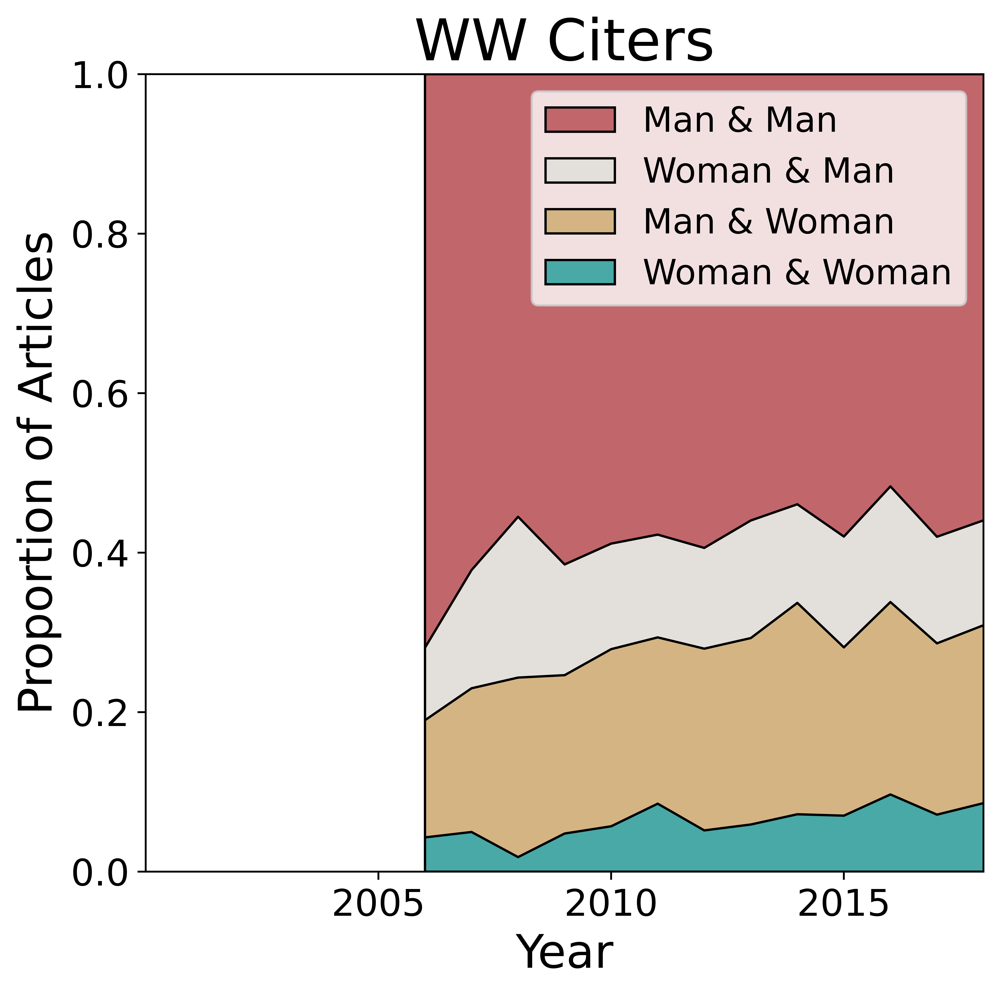

In [60]:
def gender_graphs(dataset,scope,author,model,analysis,self_cite='',thresh=25):
    ###### CONDITIONAL TO ENSURE WE RE NOT RUNNING ONE OF THE SUBANALYSIS
    if analysis not in ['75_con','include_self_cite']:
        # Reading in Dataframes for authorship
        df_yearly=pd.read_csv('coreidd/Figures/df_fig1_pairings_'+dataset+'_'+model+'_'+scope+'_'+author+'.csv')
        df_yearly_author=pd.read_csv('coreidd/Figures/df_fig1_authors_'+dataset+'_'+model+'_'+scope+'_'+author+'.csv')
        df_genders=pd.read_csv('coreidd/Figures/df_fig1_genders_'+dataset+'_'+model+'_'+scope+'_'+author+'.csv')
        genders=df_genders['Items'].to_list()

###################################### FIRST/LAST AUTHORSHIP FIGURE #########################################
        fig,ax=plt.subplots(figsize=(6,6),dpi=1000)
        plt.subplots_adjust(left=0.15,right=.99,bottom=0.12,top=0.92)

        ax.stackplot(df_yearly_author['Year'],  df_yearly_author['Woman'],  df_yearly_author["Man"],
                          labels=['Woman','Man'],
                          colors=['#48A9A6','#C1666B'],ec='black')

        ## AXIS PARAMETERS FOR GRAPH1
        handles, labels = ax.get_legend_handles_labels()
        ax.legend(handles[::-1], labels[::-1], loc='upper right',fontsize=15)
        ax.set_ylim(0,1)
        folder=dataset.title()
        ax.set_xlim(2000,2019)
        ax.set_xticks((2005,2010,2015))
        ax.tick_params(axis='both', which='major', labelsize=16)
        ax.set_xlabel('Year', fontsize=20,fontweight='roman')
        ax.set_ylabel('Proportion of Articles', fontsize=20,fontweight='roman')
        if author=='LA':
            ax.set_title('Senior Authors', fontsize=25)
        if author=='FA':
            ax.set_title('Lead Authors', fontsize=25)


        if analysis=='main':
            plt.savefig(str('coreidd/Figures/fig2_pt1.png'),dpi=100)
        else:
            plt.savefig(str('coreidd/Figures/fig2_pt1_'+analysis+'.png'),dpi=100)

###################################### AUTHORSHIP PAIRING FIGURE ############################################
        fig,ax=plt.subplots(figsize=(6,6),dpi=1000)
        plt.subplots_adjust(left=0.15,right=.99,bottom=0.12,top=0.92)
        ax.stackplot(df_yearly['Year'],  df_yearly['WW'],  df_yearly["MW"],  df_yearly["WM"],df_yearly["MM"],
                          labels=['Woman & Woman','Man & Woman','Woman & Man','Man & Man'],
                          colors=['#48A9A6','#D4B483','#E3DFDA','#C1666B'],ec='black')

        handles, labels = ax.get_legend_handles_labels()
        ax.legend(handles[::-1], labels[::-1], loc='upper right',fontsize=15)
        ax.set_xlim(min(df_yearly['Year']), max(df_yearly['Year']))
        ax.set_ylim(0,1)
        folder=dataset.title()

        ## AXIS PARAMETERS FOR GRAPH2
        ax.tick_params(axis='both', which='major', labelsize=15)


        ax.set_xlim(2000,2019)
        ax.set_ylim(0,1)
        ax.set_title('Author Pairings', fontsize=25)
        folder=dataset.title()

        ax.set_xlim(2000,2019)
        ax.set_xticks((2005,2010,2015))
        ax.tick_params(axis='both', which='major', labelsize=16)

        ax.set_xlabel('Year', fontsize=20,fontweight='roman')
        ax.set_ylabel('Proportion of Articles', fontsize=20,fontweight='roman')
        if analysis=='main':
            plt.savefig(str('coreidd/Figures/fig2_pt2.png'),dpi=100)
        else:
            plt.savefig(str('coreidd/Figures/fig2_pt2_'+analysis+'.png'),dpi=100)
#################################### EXPECTED PAIRINGS GRAPHS ############################################# 
        fig,ax=plt.subplots(figsize=(1,6),dpi=1000)
        plt.subplots_adjust(left=0.15,right=.97,bottom=0.12,top=0.92)

        [LA_women,LA_men,FA_women,FA_men,women,men]=genders
        WW_x=LA_women*FA_women
        WM_x=FA_women*LA_men
        MW_x=FA_men*LA_women
        MM_x=FA_men*LA_men
        df_yearly=pd.DataFrame(data=[[0,MM_x,WM_x,MW_x,WW_x],[1,MM_x,WM_x,MW_x,WW_x]], columns=['Year','MM','WM','MW','WW'])

        ax.stackplot(df_yearly['Year'],  df_yearly['WW'],  df_yearly["MW"],  df_yearly["WM"],df_yearly["MM"],
                          labels=['Woman & Woman','Man & Woman','Woman & Man','Man & Man'],
                          colors=['#48A9A6','#D4B483','#E3DFDA','#C1666B'],ec='black')


        ax.tick_params(axis='both', which='major', labelsize=16)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_ylim(0,1)
        ax.set_xlim(0,1)
        ax.set_title('EF', fontsize=25)
        if analysis=='main':
            plt.savefig(str('coreidd/Figures/fig_2_pt2_expected.png'),dpi=100)
        else:
            plt.savefig(str('coreidd/Figures/fig_2_pt2_expected'+analysis+'.png'),dpi=100)

###################################### EXPECTED AUTHORSHIP GRAPHS ############################################
    fig,ax=plt.subplots(figsize=(1,6),dpi=1000)
    plt.subplots_adjust(left=0.15,right=.97,bottom=0.12,top=0.92)

    # GENDER POPULATION DATA COMES FROM: https://data.worldbank.org/indicator/SP.POP.TOTL.FE.ZS

    df_gender_expected=pd.DataFrame(data=[[0,.497,0.503],[1,.497,0.503]], columns=['Year','Woman','Man'])

    ax.stackplot(df_gender_expected['Year'], df_gender_expected['Woman'],df_gender_expected["Man"],
                      labels=['Woman','Man'],
                      colors=['#48A9A6','#C1666B'],ec='black')

    ax.tick_params(axis='both', which='major', labelsize=16)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_ylim(0,1)
    ax.set_xlim(0,1)
    ax.set_title('EP', fontsize=25)
    plt.savefig(str('coreidd/Figures/fig_2_pt1_expected.png'),dpi=100)
#################################### CITATION PRACTICES GRAPHS ##############################################    
    df_MM=pd.read_csv('coreidd/Figures/df_fig2_MM_'+dataset+'_'+model+'_'+scope+self_cite+'.csv')
    df_WW=pd.read_csv('coreidd/Figures/df_fig2_WW_'+dataset+'_'+model+'_'+scope+self_cite+'.csv')
    df_MM=df_MM.sort_values(by='Year')
    df_WW=df_WW.sort_values(by='Year')
    
    dfs=[df_MM,df_WW]
    for x in range(0,2):
        fig,ax=plt.subplots(figsize=(6,6),dpi=1000)
        plt.subplots_adjust(left=0.15,right=.99,bottom=0.12,top=0.92)
        df_yearly=dfs[x]
        firstyear=df_yearly['Year'].loc[df_yearly['num_cite']<=thresh].max()
        df_yearly.loc[df_yearly['Year'] <= firstyear, ['WW', 'ANY_POC']] = np.nan
        ax.stackplot(df_yearly['Year'],  df_yearly['WW'],  df_yearly["WM"],  df_yearly["MW"],df_yearly["MM"],
                      labels=['Woman & Woman','Man & Woman','Woman & Man','Man & Man'],
                      colors=['#48A9A6','#D4B483','#E3DFDA','#C1666B'],ec='black')




        ax.tick_params(axis='both', which='major', labelsize=16)
        ax.set_xlabel('Year', fontsize=20)
        ax.set_ylabel('Proportion of Articles', fontsize=20)
        ax.set_ylim(0,1)
        ax.set_xlim(2000,2018)
        ax.set_xticks((2005,2010,2015))
        handles, labels = ax.get_legend_handles_labels()
        ax.legend(handles[::-1], labels[::-1], loc='upper right',fontsize=15)
        if analysis=='main':
            if x==1:
                ax.set_title('WW Citers', fontsize=25)
                plt.savefig(str('coreidd/Figures/fig2_WW.png'),dpi=100)

            else:
                ax.set_title('MM Citers', fontsize=25)
                plt.savefig(str('coreidd/Figures/fig2_MM.png'),dpi=100)
        else:
            if x==1:
                ax.set_title('WW Citers', fontsize=25)
                plt.savefig(str('coreidd/Figures/fig2_WW_'+analysis+'.png'),dpi=100)

            else:
                ax.set_title('MM Citers', fontsize=25)
                plt.savefig(str('coreidd/Figures/fig2_MM_'+analysis+'.png'),dpi=100)



gender_graphs('Highly Cited','World','LA','Genderize','main')

## Race Graphs

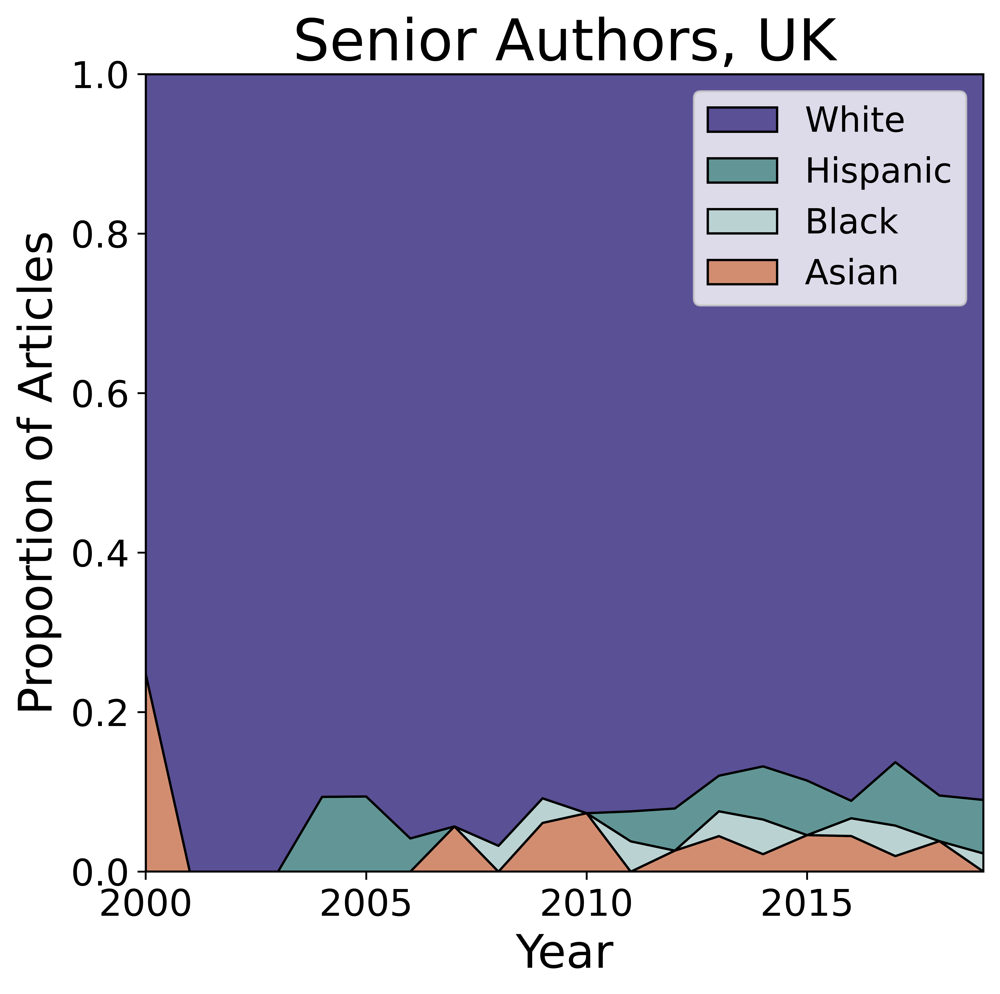

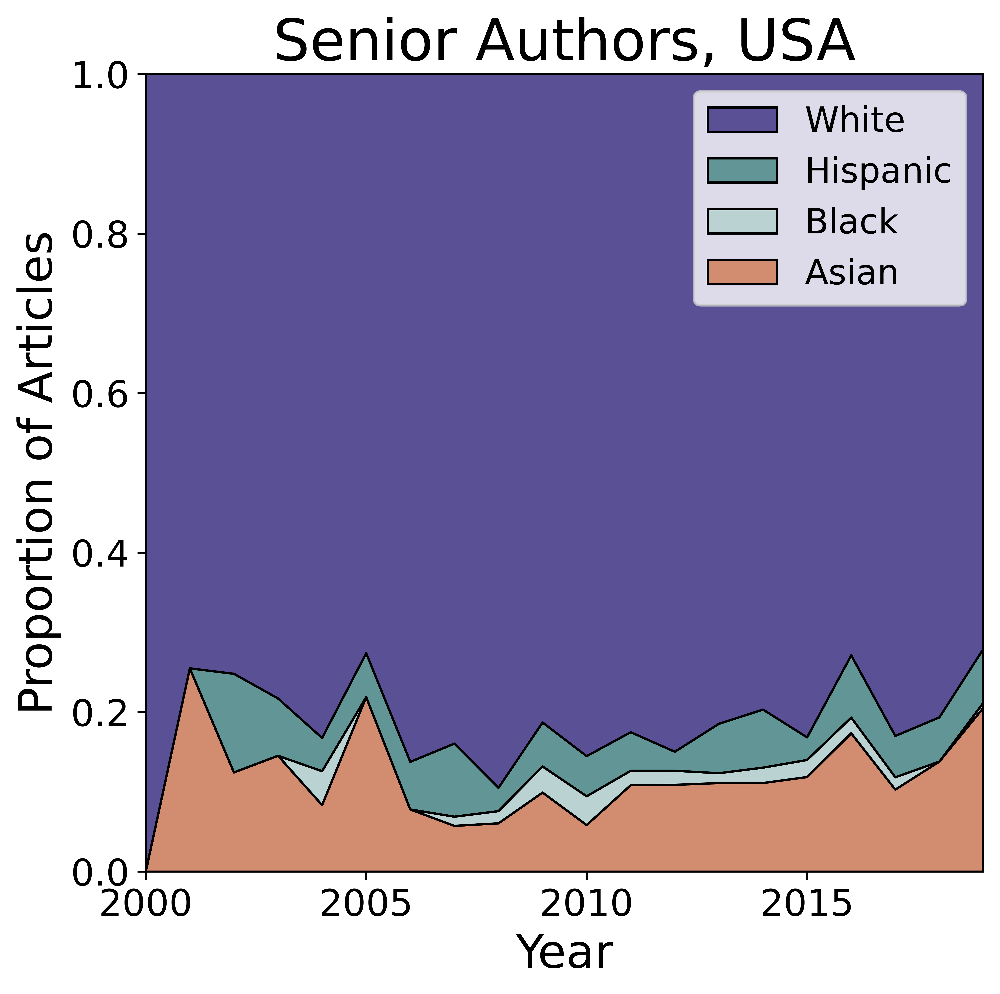

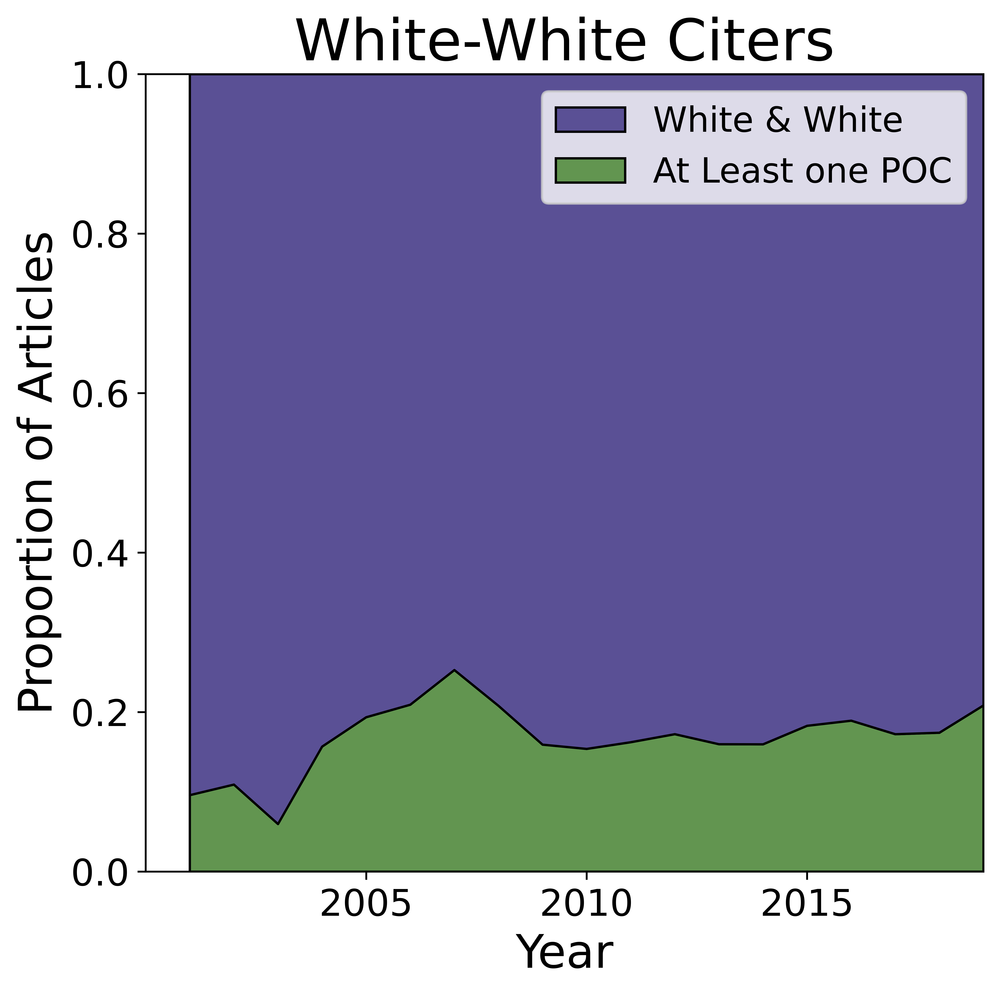

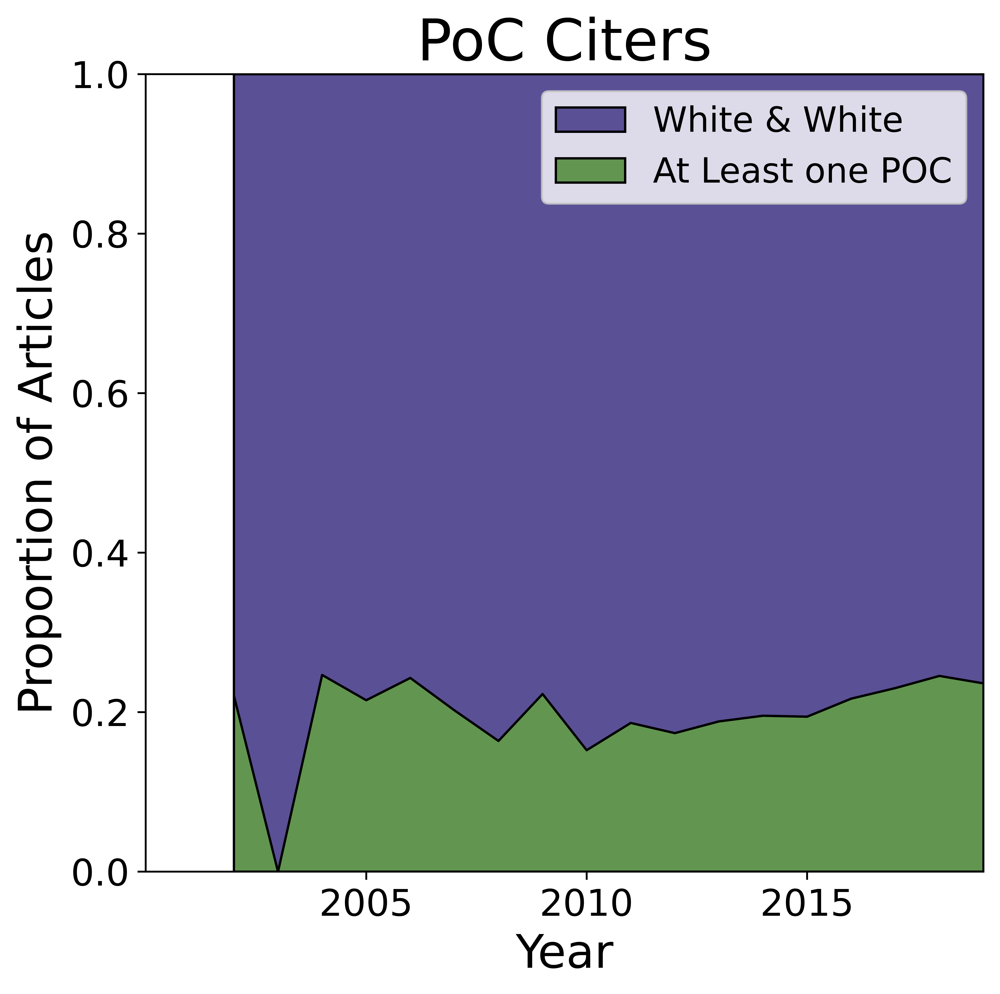

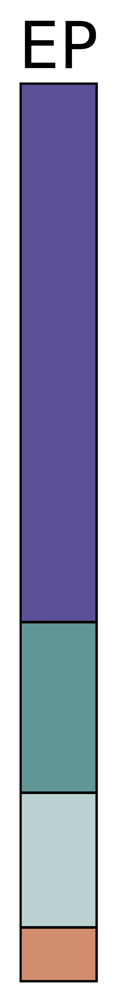

...

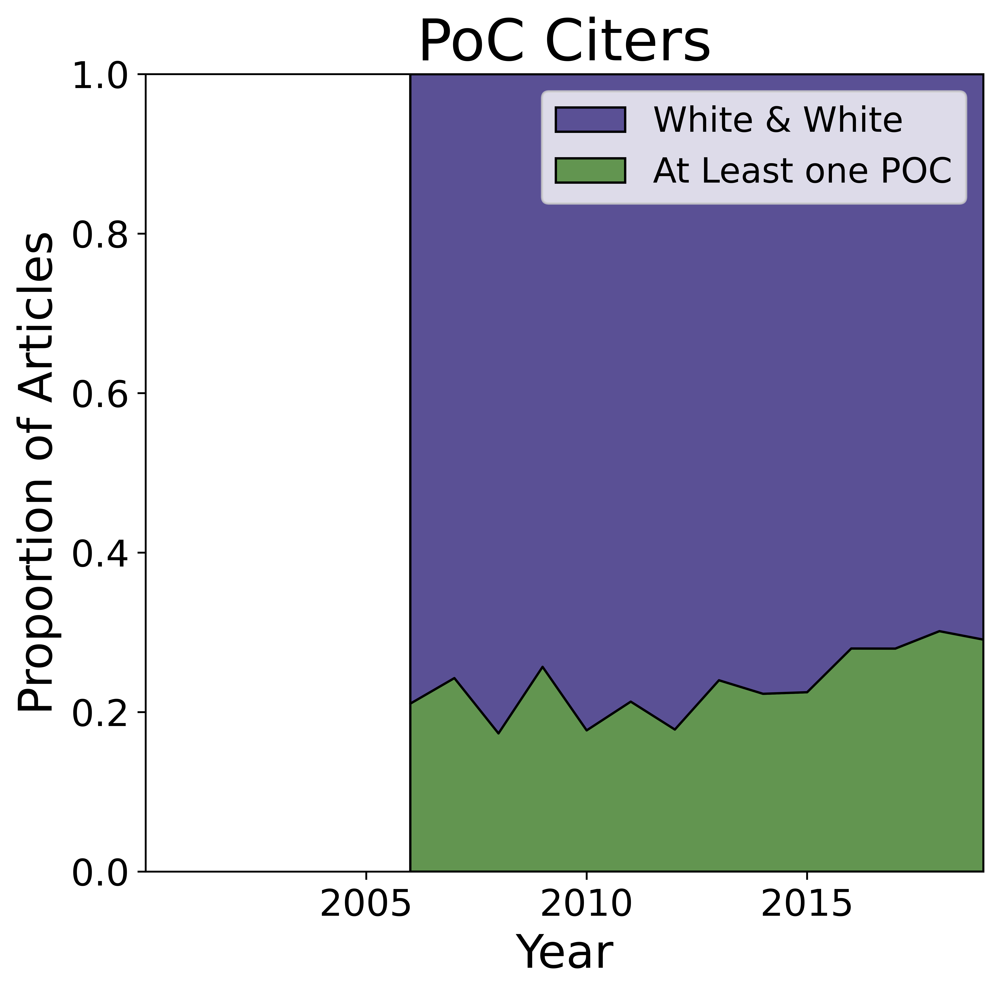

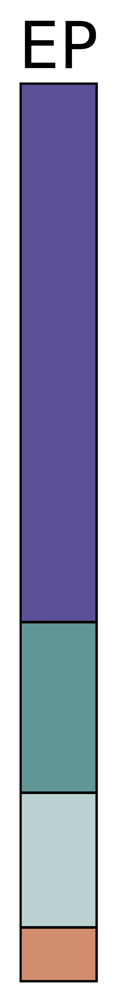

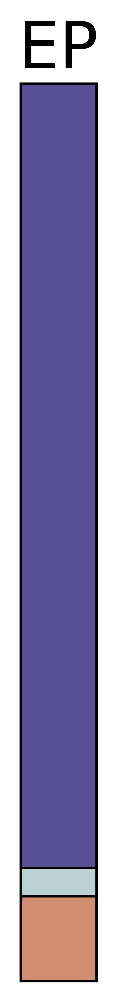

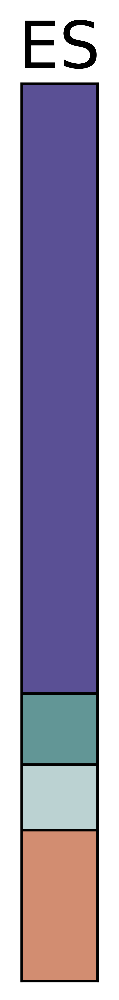

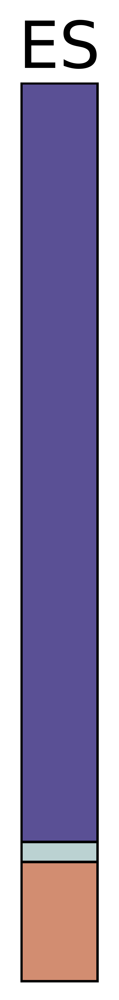

In [62]:
def race_graphs(dataset,scope1,scope2,author,model,analysis,self_cite='',thresh=25):
    
    df_WW=pd.read_csv('coreidd/Figures/df_fig4_WW_'+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+'.csv')
    df_PoC=pd.read_csv('coreidd/Figures/df_fig4_PoC_'+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+'.csv')
    
    ###### CONDITIONAL TO ENSURE WE RE NOT RUNNING ONE OF SUBANALYSIS
    if analysis not in ['75_con','include_self_cite']:
        df_UK=pd.read_csv('coreidd/Figures/df_fig3_authors_'+dataset+'_'+model+'_UK_'+author+'.csv')
        df_USA=pd.read_csv('coreidd/Figures/df_fig3_authors_'+dataset+'_'+model+'_USA_'+author+'.csv')
        
################################# GRAPHING AUTHORSHIP IN UK ##############################################
        fig,ax=plt.subplots(figsize=(6,6),dpi=1000)
        plt.subplots_adjust(left=0.15,right=.99,bottom=0.12,top=0.92)

        ax.stackplot(df_UK['Year'],  df_UK['A'], df_UK['B'],
                      df_UK['H'], df_UK['W'],
                          labels=['Asian','Black','Hispanic','White'],
                          colors=['#d28d71','#bbd2d2','#629696','#5a5095'],ec='black')

        handles, labels = ax.get_legend_handles_labels()
        ax.legend(handles[::-1], labels[::-1], loc='upper right',fontsize=15)
        ax.set_ylim(0,1)
        folder=dataset.title()
        ax.set_xlim(2000,2019)
        ax.set_xticks((2000,2005,2010,2015))
        ax.tick_params(axis='both', which='major', labelsize=16)
        ax.set_xlabel('Year', fontsize=20,fontweight='roman')
        ax.set_ylabel('Proportion of Articles', fontsize=20,fontweight='roman')
        if author=='LA':
            ax.set_title('Senior Authors, UK', fontsize=25)
        if author=='FA':
            ax.set_title('Lead Authors, UK', fontsize=25)


        if analysis=='main':
            plt.savefig(str('coreidd/Figures/fig3_pt1_UK.png'),dpi=100)
        else: 
            plt.savefig(str("coreidd/Figures/fig3_pt1_UK_"+analysis+".png"))
################################# GRAPHING AUTHORSHIP IN US ##############################################
        fig,ax=plt.subplots(figsize=(6,6),dpi=1000)
        plt.subplots_adjust(left=0.15,right=.99,bottom=0.12,top=0.92)
        ax.stackplot(df_USA['Year'],  df_USA['A'], df_USA['B'],df_USA['H'], df_USA['W'],
                          labels=['Asian','Black','Hispanic','White'],
                          colors=['#d28d71','#bbd2d2','#629696','#5a5095'],ec='black')

        ax.set_ylim(0,1)
        ax.set_xlim(2000,2019)
        ax.set_xticks((2000,2005,2010,2015))
        ax.tick_params(axis='both', which='major', labelsize=16)
        ax.set_xlabel('Year', fontsize=20)
        ax.set_ylabel('Proportion of Articles', fontsize=20)
        if author=='LA':
            ax.set_title('Senior Authors, USA', fontsize=25)
        if author=='FA':
            ax.set_title('Lead Authors, USA', fontsize=25)

        handles, labels = ax.get_legend_handles_labels()
        ax.legend(handles[::-1], labels[::-1], loc='upper right',fontsize=15)
        if analysis=='main':
            plt.savefig(str('coreidd/Figures/fig3_pt1_USA.png'),dpi=100)
        else:
            plt.savefig("coreidd/Figures/fig3_pt1_USA_"+analysis+".png")

################################# GRAPHING CITATION OF WW ARTICLES ############################################## 
    
    fig,ax=plt.subplots(figsize=(6,6),dpi=1000)
    plt.subplots_adjust(left=0.15,right=.99,bottom=0.12,top=0.92)
    firstyear=df_WW['Year'].loc[df_WW['num_cite']<=thresh].max()
    df_WW.loc[df_WW['Year'] <= firstyear, ['WW', 'ANY_POC']] = np.nan
    ax.stackplot(df_WW['Year'],  df_WW['ANY_POC'],df_WW["WW"],
                      labels=['At Least one POC','White & White'],
                      colors=['#629550','#5a5095'],ec='black')



    ax.set_title('White-White Citers', fontsize=25)

    ax.tick_params(axis='both', which='major', labelsize=16)
    ax.set_xlabel('Year', fontsize=20)
    ax.set_ylabel('Proportion of Articles', fontsize=20)
    ax.set_ylim(0,1)
    ax.set_xlim(2000,2019)
    ax.set_xticks((2005,2010,2015))
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles[::-1], labels[::-1], loc='upper right',fontsize=15)


    
    
    if analysis=='main':
        plt.savefig(str('coreidd/Figures/fig3_pt3_WW.png'),dpi=100)
    else:
        plt.savefig("coreidd/Figures/fig3_pt3_WW_"+analysis+".png")
    
    
################################# GRAPHING CITATION OF PoC ARTICLES ############################################## 
 
    fig,ax=plt.subplots(figsize=(6,6),dpi=1000)
    plt.subplots_adjust(left=0.15,right=.99,bottom=0.12,top=0.92)
    df_PoC['ANY_POC'].loc[df_PoC['num_cite']<=25]=np.nan
    firstyear=df_PoC['Year'].loc[df_PoC['num_cite']<=thresh].max()
    df_PoC.loc[df_PoC['Year'] <= firstyear, ['WW', 'ANY_POC']] = np.nan

    ax.stackplot(df_PoC['Year'],  df_PoC['ANY_POC'],df_PoC["WW"],
                      labels=['At Least one POC','White & White'],
                      colors=['#629550','#5a5095'],ec='black')



    ax.set_title('PoC Citers', fontsize=25)

    ax.tick_params(axis='both', which='major', labelsize=16)
    ax.set_xlabel('Year', fontsize=20)
    ax.set_ylabel('Proportion of Articles', fontsize=20)
    ax.set_ylim(0,1)
    ax.set_xlim(2000,2019)
    ax.set_xticks((2005,2010,2015))
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles[::-1], labels[::-1], loc='upper right',fontsize=15)
    ax.margins(x=0)

    
    
    if analysis=='main':
        plt.savefig(str('coreidd/Figures/fig3_pt3_PoC.png'),dpi=100)
    else:
        plt.savefig("coreidd/Figures/fig3_pt3_PoC_"+analysis+".png")

######################## GRAPHING POPULATIONS OF US AND UK FOR COMPARISON ######################################
    countries=['USA','UK']
    for scope in countries:
        fig,ax=plt.subplots(figsize=(0.5,6),dpi=1000)
        plt.subplots_adjust(left=0.15,right=.97,bottom=0.12,top=0.92)
        
        if scope=='UK':
            W=0.83
            B=0.03
            A=0.09


            df_yearly=pd.DataFrame(data=[[0,W,B,A],[1,W,B,A]], columns=['Year','W','B','A'])

            ax.stackplot(df_yearly['Year'],  df_yearly['A'], df_yearly['B'],df_yearly['W'],
                                  labels=['Asian','Black','Hispanic','White'],
                                  colors=['#d28d71','#bbd2d2','#5a5095'],ec='black')
            ax.set_ylim(0,.95)
            ax.set_title('EP', fontsize=25)
        if scope=='USA':
            W=0.60
            B=0.15
            A=0.06
            H=0.19
            df_yearly=pd.DataFrame(data=[[0,W,B,A,H],[1,W,B,A,H]], columns=['Year','W','B','A','H'])

            ax.stackplot(df_yearly['Year'],  df_yearly['A'], df_yearly['B'],df_yearly['H'],df_yearly['W'],
                                      labels=['Asian','Black','Hispanic','White'],
                                      colors=['#d28d71','#bbd2d2','#629696','#5a5095'],ec='black')
            ax.set_ylim(0,1)
            ax.set_title('EP', fontsize=25)

        ax.tick_params(axis='both', which='major', labelsize=16)
        ax.set_xticks([])
        ax.set_yticks([])

        ax.set_xlim(0,1)
        plt.savefig(str('coreidd/Figures/fig_3_pt1_'+scope+'_expected.png'),dpi=100)


######################## GRAPHING POPULATIONS OF US AND UK FOR STEMWORKFORCE COMPARISON ######################################
    countries=['USA','UK']
    for scope in countries:
        fig,ax=plt.subplots(figsize=(0.5,6),dpi=1000)
        plt.subplots_adjust(left=0.15,right=.97,bottom=0.12,top=0.92)
        
        if scope=='UK':
            W=0.81/0.95
            B=0.02/0.95
            A=0.12/0.95


            df_yearly=pd.DataFrame(data=[[0,W,B,A],[1,W,B,A]], columns=['Year','W','B','A'])

            ax.stackplot(df_yearly['Year'],  df_yearly['A'], df_yearly['B'],df_yearly['W'],
                                  labels=['Asian','Black','Hispanic','White'],
                                  colors=['#d28d71','#bbd2d2','#5a5095'],ec='black')
            ax.set_ylim(0,.95)
            ax.set_title('ES', fontsize=25)
        if scope=='USA':
            W=0.662/0.974
            B=0.071/.974
            A=0.164/0.974
            H=0.077/0.974
            df_yearly=pd.DataFrame(data=[[0,W,B,A,H],[1,W,B,A,H]], columns=['Year','W','B','A','H'])

            ax.stackplot(df_yearly['Year'],  df_yearly['A'], df_yearly['B'],df_yearly['H'],df_yearly['W'],
                                      labels=['Asian','Black','Hispanic','White'],
                                      colors=['#d28d71','#bbd2d2','#629696','#5a5095'],ec='black')
            ax.set_ylim(0,1)
            ax.set_title('ES', fontsize=25)

        ax.tick_params(axis='both', which='major', labelsize=16)
        ax.set_xticks([])
        ax.set_yticks([])

        ax.set_xlim(0,1)
        plt.savefig(str('coreidd/Figures/fig_3_pt1_'+scope+'_SWF_expected.png'),dpi=100)

race_graphs('Highly Cited','Global North','Global North','LA','Ethnicolr','main')
race_graphs('Highly Cited','Global North','Global North','LA','Namsor','Namsor')
race_graphs('Highly Cited','Global North','Global North','FA','Ethnicolr','FA')
race_graphs('Books','Global North','Global North','LA','Ethnicolr','Books')
race_graphs('Highly Cited_75','Global North','Global North','LA','Ethnicolr','75_con')
race_graphs('Highly Cited_60','Global North','Global North','LA','Ethnicolr','60_thresh')
race_graphs('Highly Cited_80','Global North','Global North','LA','Ethnicolr','80_thresh')
race_graphs('Highly Cited','Global North','Global North','LA','Ethnicolr','include_self_cite',self_cite='_include_self_cite')

In [63]:
## T TEST FOR WW and PoC authors Citing WW authors
import scipy.stats as stats
import pymannkendall as pmk
def race_citation_stats(dataset,scope1,scope2,author,model,analysis,self_cite='',thresh=25):
    df_WW_citing_POC=pd.read_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Race/WW_citing_POC"+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+".csv")
    df_WW_citing_WW=pd.read_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Race/WW_citing_WW"+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+".csv")
          
    df_POC_citing_POC=pd.read_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Race/POC_citing_POC"+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+".csv")
    df_POC_citing_WW=pd.read_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Race/POC_citing_WW"+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+".csv")
            

    df_WW=pd.read_csv('coreidd/Figures/df_fig4_WW_'+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+'.csv')
    df_PoC=pd.read_csv('coreidd/Figures/df_fig4_PoC_'+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+'.csv')
        
    df_POC_citing_WW=df_POC_citing_WW.drop('Unnamed: 0', axis=1)
    df_WW_citing_WW=df_WW_citing_WW.drop('Unnamed: 0', axis=1)
    df_POC_citing_POC=df_POC_citing_POC.drop('Unnamed: 0' ,axis=1)
    df_WW_citing_POC=df_WW_citing_POC.drop('Unnamed: 0', axis=1)
    
    firstyear=df_PoC['Year'].loc[df_PoC['num_cite']<=thresh].max()
    df_PoC.loc[df_PoC['Year'] <= firstyear, ['Year']] = np.nan
    
    years=df_PoC['Year'].dropna().to_list()
    years=[str(round(x)) for x in years]
    t_test=pd.DataFrame(columns=['Year','T Statistic','P Value'])
    
    
    for x in range(0,len(years)):
        year=years[x]

        WW_list=df_WW_citing_POC[year].to_list()
        POC_list=df_POC_citing_POC[year].to_list()
        
        t_statistic, p_value = stats.ttest_ind(WW_list, POC_list,alternative='less',equal_var=False)
        t_test.loc[len(t_test)] = [year,t_statistic,p_value]
        data = [WW_list, POC_list]
    
    
    
    t_test.to_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Race/results"+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+".csv")
    


    print('Statistically signicficant years:',sorted(t_test['Year'].loc[t_test['P Value']<=0.05].to_list()))  
    df_WW=pd.read_csv('coreidd/Figures/df_fig4_WW_'+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+'.csv')
    df_PoC=pd.read_csv('coreidd/Figures/df_fig4_PoC_'+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+'.csv')

    #MANN KENDALL Test FOR TRENDS OVER TIME
    pairs=[(df_WW,'WW'),(df_PoC,'PoC')]
    for df,group in pairs:
        df=df.sort_values(by='Year',ascending=True)
        firstyear=df['Year'].loc[df['num_cite']<=thresh].max()
        df['ANY_POC'].loc[df['Year']<firstyear]=np.nan
        over_time=df['ANY_POC'].to_list()
        print(group,'citing PoC:',pmk.original_test(over_time))
    return t_test
t_test=race_citation_stats('Highly Cited','Global North','Global North','LA','Ethnicolr','remake')

Statistically signicficant years: ['2009', '2013', '2017', '2018', '2019']
WW citing PoC: Mann_Kendall_Test(trend='increasing', h=True, p=0.017863627708934793, z=2.368432748509133, Tau=0.3894736842105263, s=74.0, var_s=950.0, slope=0.004486354772747609, intercept=0.12472954802725505)
PoC citing PoC: Mann_Kendall_Test(trend='no trend', h=False, p=0.15120530617129546, z=1.43528708612871, Tau=0.24561403508771928, s=42.0, var_s=816.0, slope=0.0029683316113408437, intercept=0.17266692179571916)


In [65]:
t_test.sort_values(by='Year')

,Year,T Statistic,P Value
0,2002,-2.159209,0.051333
1,2003,6.065150,0.986938
2,2004,-1.587541,0.126418
3,2005,-0.629246,0.293495
4,2006,-2.110861,0.083784
5,2007,2.151821,0.936040
6,2008,1.520324,0.866670
7,2009,-4.078884,0.021844
8,2010,0.116609,0.541095
9,2011,-1.618829,0.107548


In [66]:
def gender_citation_stats(dataset,scope,author,model,analysis,self_cite='',thresh=25):
    df_MM_citing_WW=pd.read_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Gender/MM_citing_WW"+dataset+'_'+model+'_'+scope+self_cite+".csv")
    df_MM_citing_WM=pd.read_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Gender/MM_citing_WM"+dataset+'_'+model+'_'+scope+self_cite+".csv")
    df_MM_citing_MW=pd.read_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Gender/MM_citing_MW"+dataset+'_'+model+'_'+scope+self_cite+".csv")
    df_MM_citing_MM=pd.read_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Gender/MM_citing_MM"+dataset+'_'+model+'_'+scope+self_cite+".csv")
    
    df_WW_citing_WW=pd.read_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Gender/WW_citing_WW"+dataset+'_'+model+'_'+scope+self_cite+".csv")
    df_WW_citing_WM=pd.read_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Gender/WW_citing_WM"+dataset+'_'+model+'_'+scope+self_cite+".csv")
    df_WW_citing_MW=pd.read_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Gender/WW_citing_MW"+dataset+'_'+model+'_'+scope+self_cite+".csv")
    df_WW_citing_MM=pd.read_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Gender/Ww_citing_MM"+dataset+'_'+model+'_'+scope+self_cite+".csv")

    df_MM=pd.read_csv('coreidd/Figures/df_fig2_MM_'+dataset+'_'+model+'_'+scope+'.csv')
    df_WW=pd.read_csv('coreidd/Figures/df_fig2_WW_'+dataset+'_'+model+'_'+scope+'.csv')
    
    t_test=pd.DataFrame(columns=['Year','T Statistic','P Value'])
    firstyear=df_WW['Year'].loc[df_WW['num_cite']<=thresh].max()
    for year in range(int(firstyear)+1,2019):
        
        year=float(year)
        year=str(year)
        try:
            MM_list = [1-value for value in df_MM_citing_MM[year].to_list()]
            WW_list = [1-value for value in df_WW_citing_MM[year].to_list()]
            
            #WW_list = [sum(values) for values in zip(df_WW_citing_WW[year], df_WW_citing_WM[year], df_WW_citing_MW[year])]
            t_statistic, p_value = stats.ttest_ind(MM_list, WW_list,alternative='less',equal_var=False)
    
            t_test.loc[len(t_test)] = [year,t_statistic,p_value]
        except: 
            t_test.loc[len(t_test)] = [year,np.nan,np.nan]
    print('Statistically signicficant years:',sorted(t_test['Year'].loc[t_test['P Value']<=0.05].to_list()))  
    df_MM['ANY_W']=df_MM['WW']+df_MM['WM']+df_MM['MW']
    df_WW['ANY_W']=df_WW['WW']+df_WW['WM']+df_WW['MW']
    pairs=[(df_WW,'WW'),(df_MM,'MM')]
    
    for df,group in pairs:
        df=df.sort_values(by='Year',ascending=True)
        firstyear=df['Year'].loc[df['num_cite']<=thresh].max()
        df['ANY_W'].loc[df['Year']<firstyear]=np.nan
        over_time=df['ANY_W'].to_list()
        print(group,'citing W:',pmk.original_test(over_time))
    #t_test.loc[t_test['P Value']>=0.05].sort_values(by='Year')
    t_test.to_csv("/Users/alexesmerritt/Library/CloudStorage/GoogleDrive-akm147@georgetown.edu/My Drive/citation_bias/Alexes' Section/T-Test/Gender/results"+dataset+'_'+model+'_'+scope+self_cite+".csv")
    return t_test
gender_citation_stats('Highly Cited','World','LA','Genderize','main')

Statistically signicficant years: ['2006.0', '2007.0', '2008.0', '2009.0', '2010.0', '2011.0', '2012.0', '2013.0', '2014.0', '2015.0', '2016.0', '2017.0', '2018.0']
WW citing W: Mann_Kendall_Test(trend='increasing', h=True, p=0.004101400861903803, z=2.8702556239712824, Tau=0.5619047619047619, s=59.0, var_s=408.3333333333333, slope=0.006165042539934301, intercept=0.3586155815486558)
MM citing W: Mann_Kendall_Test(trend='increasing', h=True, p=0.002054718976131742, z=3.082207001484488, Tau=0.5052631578947369, s=96.0, var_s=950.0, slope=0.010952581127276708, intercept=0.20561277070963968)


,Year,T Statistic,P Value
0,2006.0,-28.247575,1.133385e-140
1,2007.0,-47.010509,1.451589e-274
2,2008.0,-76.171124,0.000000e+00
3,2009.0,-22.021854,4.905760e-92
4,2010.0,-31.170907,7.523958e-163
5,2011.0,-62.837610,0.000000e+00
6,2012.0,-72.697289,0.000000e+00
7,2013.0,-116.918998,0.000000e+00
8,2014.0,-111.196764,0.000000e+00
9,2015.0,-103.552485,0.000000e+00


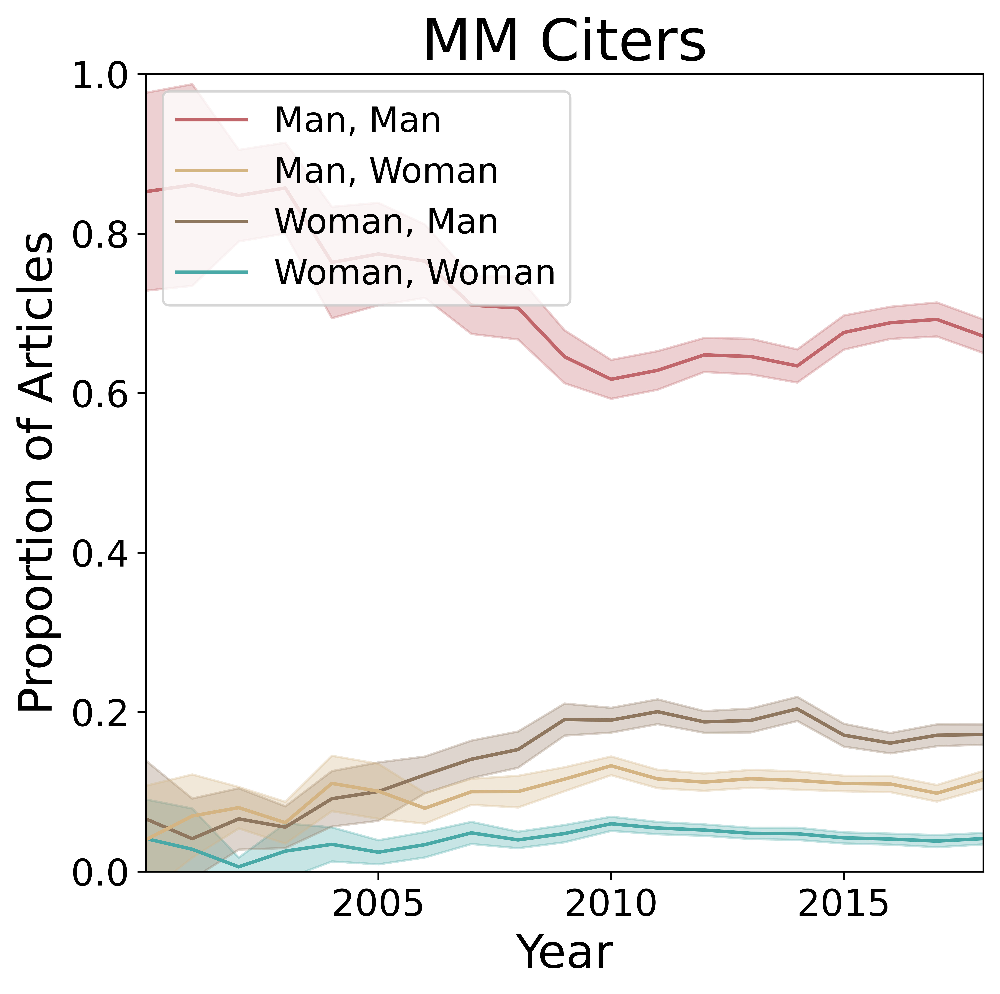

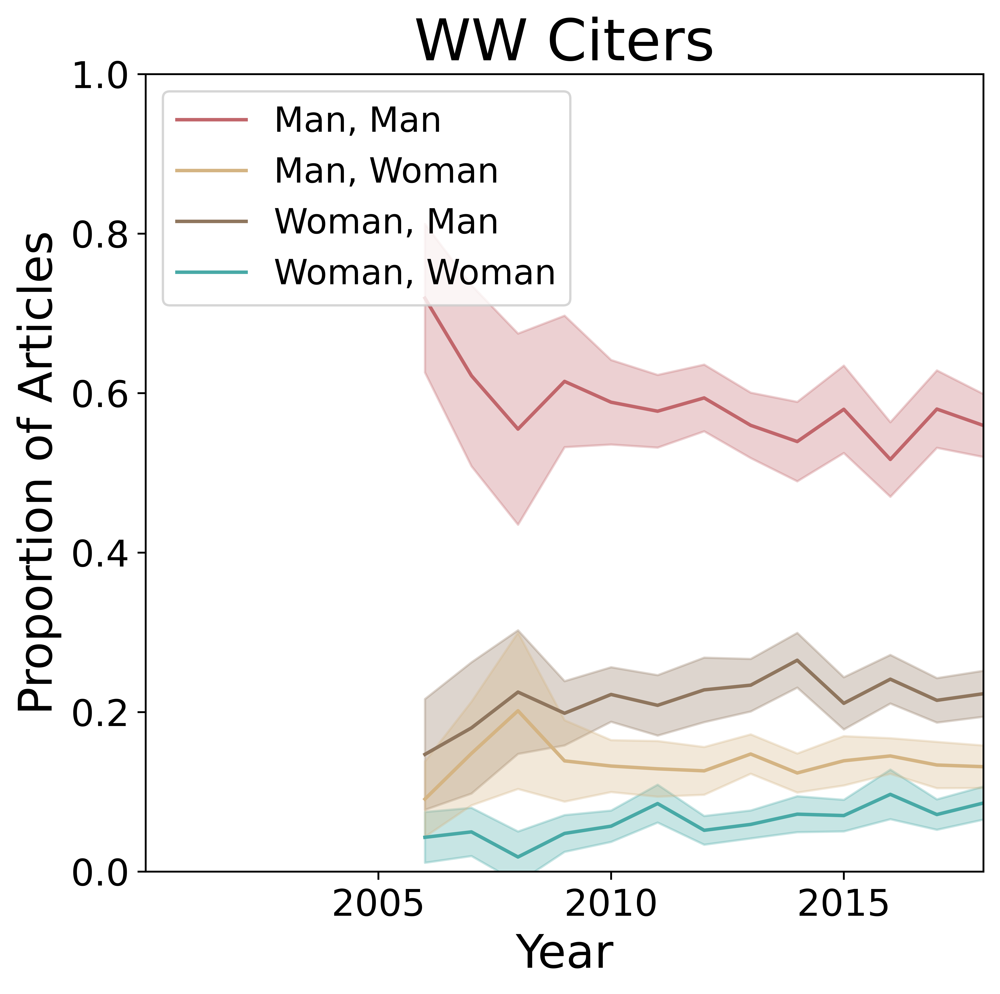

In [67]:
def gender_std_graph(dataset,model,scope,self_cite='',thresh=25):
    df_MM=pd.read_csv('coreidd/Figures/df_fig2_MM_'+dataset+'_'+model+'_'+scope+self_cite+'.csv')
    df_WW=pd.read_csv('coreidd/Figures/df_fig2_WW_'+dataset+'_'+model+'_'+scope+self_cite+'.csv')

    
    colors={'WW':'#48A9A6','WM':'#8f765e','MW':'#D4B483','MM':'#C1666B'}
    df_MM=df_MM.sort_values(by='Year')
    df_WW=df_WW.sort_values(by='Year')
    dfs=[df_MM,df_WW]
    for x in range(0,2):
        fig,ax=plt.subplots(figsize=(6,6),dpi=1000)
        plt.subplots_adjust(left=0.15,right=.99,bottom=0.12,top=0.92)
        df_fig1=dfs[x]
        firstyear=df_fig1['Year'].loc[df_fig1['num_cite']<=thresh].max()
        df_fig1.loc[df_fig1['Year'] <= firstyear, ['WW', 'MW','WM','MM']] = np.nan

        ax.plot(df_fig1['Year'],df_fig1['WW'],color=colors['WW'],label='Woman, Woman')
        ax.plot(df_fig1['Year'],df_fig1['WM'],color=colors['WM'],label='Woman, Man')
        ax.plot(df_fig1['Year'],df_fig1['MW'],color=colors['MW'],label='Man, Woman')
        ax.plot(df_fig1['Year'],df_fig1['MM'],color=colors['MM'],label='Man, Man')


        ax.fill_between(df_fig1['Year'],(df_fig1['WW']+2*df_fig1['WW_std']),
                            (df_fig1['WW']-2*df_fig1['WW_std']),color=colors['WW'],alpha=0.3)
        ax.fill_between(df_fig1['Year'],(df_fig1['WM']+2*df_fig1['WM_std']),
                            (df_fig1['WM']-2*df_fig1['WM_std']),color=colors['WM'],alpha=0.3)
        ax.fill_between(df_fig1['Year'],(df_fig1['MW']+2*df_fig1['MW_std']),
                            (df_fig1['MW']-2*df_fig1['MW_std']),color=colors['MW'],alpha=0.3)
        ax.fill_between(df_fig1['Year'],(df_fig1['MM']+2*df_fig1['MM_std']),
                            (df_fig1['MM']-2*df_fig1['MM_std']),color=colors['MM'],alpha=0.3)






        ax.tick_params(axis='both', which='major', labelsize=16)
        ax.set_xlabel('Year', fontsize=20)
        ax.set_ylabel('Proportion of Articles', fontsize=20)
        ax.set_ylim(0,1)
        ax.set_xlim(2000,2018)
        ax.set_xticks((2005,2010,2015))
        handles, labels = ax.get_legend_handles_labels()
        ax.legend(handles[::-1], labels[::-1], loc='upper left',fontsize=15)
        if x==1:
            ax.set_title('WW Citers', fontsize=25)
            plt.savefig(str('coreidd/Figures/fig2_STD_WW.png'),dpi=100)

        else:
            ax.set_title('MM Citers', fontsize=25)
            plt.savefig(str('coreidd/Figures/fig2_STD_MM.png'),dpi=100)
gender_std_graph('Highly Cited','Genderize','World')



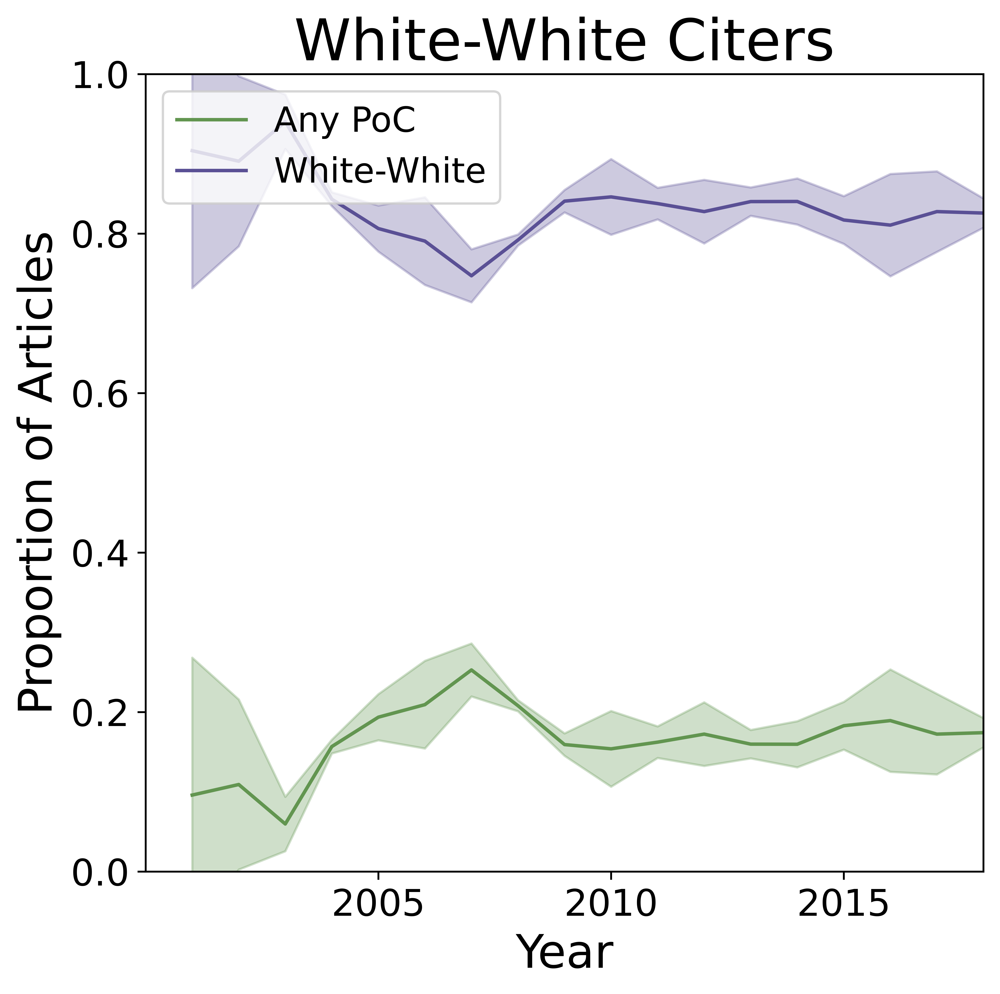

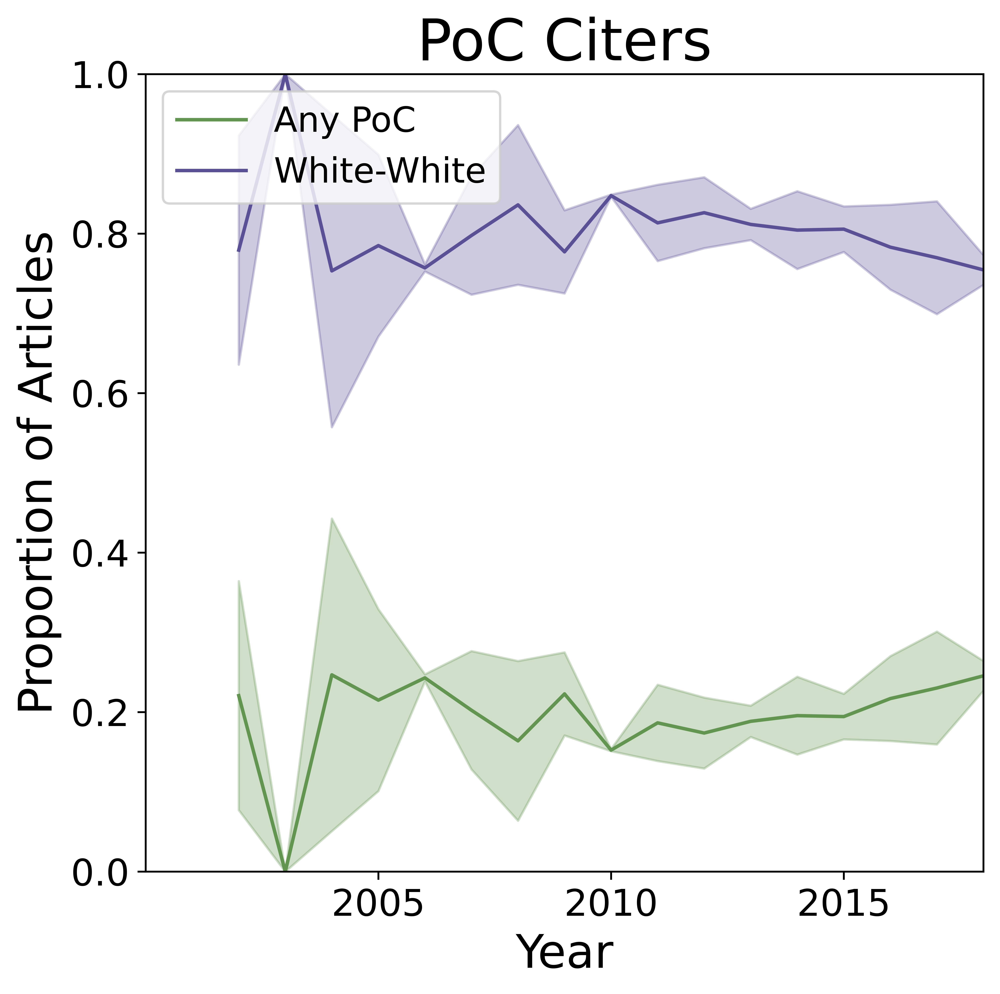

In [68]:
def race_std_graph(dataset,model,scope1,scope2,self_cite='',thresh=25):
    df_WW=pd.read_csv('coreidd/Figures/df_fig4_WW_'+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+'.csv')
    df_PoC=pd.read_csv('coreidd/Figures/df_fig4_PoC_'+dataset+'_'+model+'_'+scope1+'_'+scope2+self_cite+'.csv')

    colors={'PoC':'#629550','WW':'#5a5095'}

    df_PoC=df_PoC.sort_values(by='Year')
    df_WW=df_WW.sort_values(by='Year')
    dfs=[df_WW,df_PoC]
    for x in range(0,2):
        fig,ax=plt.subplots(figsize=(6,6),dpi=1000)
        plt.subplots_adjust(left=0.15,right=.99,bottom=0.12,top=0.92)
        df_fig1=dfs[x]
        firstyear=df_fig1['Year'].loc[df_fig1['num_cite']<=thresh].max()
        df_fig1.loc[df_fig1['Year'] <= firstyear, ['WW', 'ANY_POC']] = np.nan
        
        ax.plot(df_fig1['Year'],df_fig1['WW'],color=colors['WW'],label='White-White')
        ax.plot(df_fig1['Year'],df_fig1['ANY_POC'],color=colors['PoC'],label='Any PoC')

        ax.fill_between(df_fig1['Year'],(df_fig1['ANY_POC']+2*df_fig1['POC_STD']),
                            (df_fig1['ANY_POC']-2*df_fig1['POC_STD']),color=colors['PoC'],alpha=0.3)
        ax.fill_between(df_fig1['Year'],(df_fig1['WW']+2*df_fig1['WW_std']),
                            (df_fig1['WW']-2*df_fig1['WW_std']),color=colors['WW'],alpha=0.3)






        ax.tick_params(axis='both', which='major', labelsize=16)
        ax.set_xlabel('Year', fontsize=20)
        ax.set_ylabel('Proportion of Articles', fontsize=20)
        ax.set_ylim(0,1)
        ax.set_xlim(2000,2018)
        ax.set_xticks((2005,2010,2015))
        handles, labels = ax.get_legend_handles_labels()
        ax.legend(handles[::-1], labels[::-1], loc='upper left',fontsize=15)
        if x==1:
            ax.set_title('PoC Citers', fontsize=25)
            plt.savefig(str('coreidd/Figures/fig3_STD_PoC.png'),dpi=100)

        else:
            ax.set_title('White-White Citers', fontsize=25)
            plt.savefig(str('coreidd/Figures/fig3_STD_WW.png'),dpi=100)
race_std_graph('Highly Cited','Ethnicolr','Global North','Global North')


In [69]:
df=df_hc
df_cited=df_cited_hc

model='Ethnicolr'
include_self_cite=False
consensus=90
df=df.loc[df['has_single_author']==False]
### Renaming columns to make it clearer
df_cited=df_cited.rename(columns={'article_id':'cited_article','in_bib_of_UT':'citing_article'})
if model=='Ethnicolr':
    df_races1=df[['article_id', 'ARbin_ethni','global_north','first_auth','last_auth']]
    df_races2=df[['article_id', 'ARbin_ethni','global_north','PY','first_auth','last_auth']]
    df_races1=df_races1.rename(columns={'global_north':'global_north2'})
    #### ADD CITED AUTHORS RACE
    df_cited=df_cited.merge(df_races1, left_on='cited_article', right_on='article_id')
    df_cited=df_cited.rename(columns={'ARbin_ethni':'cited_race','first_auth':'cited_first','last_auth':'cited_last','PY':'PY_cited_paper'})
    #### ADD CITING AUTHORS RACE

    df_cited=df_cited.merge(df_races2, left_on='citing_article', right_on='article_id')
    df_cited=df_cited.rename(columns={'ARbin_ethni':'citing_race','first_auth':'citing_first','last_auth':'citing_last'})
    df_cited=df_cited.drop(columns={'UT_x','UT_y'})
    df_cited=remove_self_citations(df_cited) 
if model=='Namsor':
    df_races1=df[['article_id', 'ARbin_namsor','first_auth','last_auth','global_north']]
    df_races2=df[['article_id', 'ARbin_namsor','global_north','Country','first_auth','last_auth','PY']]
    df_races=df_races1.rename(columns={'global_north':'global_north2'})
    df_cited=df_cited.merge(df_races1, left_on='cited_article', right_on='article_id')
    df_cited=df_cited.rename(columns={'ARbin_namsor':'cited_race','first_auth':'cited_first','last_auth':'cited_last','global_north':'global_north2','PY':'PY_cited_paper'})
    df_cited=df_cited.merge(df_races2, left_on='citing_article', right_on='article_id')
    df_cited=df_cited.rename(columns={'ARbin_namsor':'citing_race','first_auth':'citing_first','last_auth':'citing_last'})
    df_cited=df_cited.drop(columns={'UT_x','UT_y'})
    df_cited=remove_self_citations(df_cited) 

if include_self_cite==False:
    df_cited=df_cited.loc[df_cited['is_self_cite']==False]



df_cited=df_cited.loc[df_cited['include_'+str(consensus)]==True] ### Making sure we use 90% consensus for the field

## Making sure the articles remaining have both races reported
groups=['WW','WN','NW','NN']
df_cited=df_cited.loc[df_cited['citing_race'].isin(groups)]

### Alterations for scope
df_cited=df_cited.loc[df_cited['cited_race'].isin(groups)]

 ### Alterations for scope

df_cited=df_cited.loc[df_cited['global_north']==1]
df_cited=df_cited.loc[df_cited['global_north2']==1]

df_cited['PY'].loc[df_cited['citing_race'].isin(['WN','NW','NN'])].value_counts(),df_cited['PY'].loc[df_cited['citing_race'].isin(['WW'])].value_counts()

KeyError: "['first_auth', 'last_auth'] not in index"